**If your device does not installed Mlxtend, Optuna, Cat Boost and XGBoost, use the below commented code to install**

In [ ]:
# pip install mlxtend

In [ ]:
# pip install catboost

In [ ]:
# pip install xgboost

<font size="5">Importing the Required Libraries.</font>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

from sklearn.preprocessing import LabelEncoder

from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

from sklearn.model_selection import GridSearchCV
import optuna
from optuna import visualization
from optuna.samplers import TPESampler

from sklearn.metrics import roc_curve, roc_auc_score, classification_report, accuracy_score, confusion_matrix, auc

from mlxtend.feature_selection import SequentialFeatureSelector
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs

import joblib

- If you have not intsalled 
- pip install optuna
- pip install xgboost
- pip install catboost

**Importing the training and label data**

In [2]:
training = pd.read_csv('training_set_features.csv')

In [3]:
training.head()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,...,income_poverty,marital_status,rent_or_own,employment_status,hhs_geo_region,census_msa,household_adults,household_children,employment_industry,employment_occupation
0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,Below Poverty,Not Married,Own,Not in Labor Force,oxchjgsf,Non-MSA,0.0,0.0,NaN,NaN
1,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,...,Below Poverty,Not Married,Rent,Employed,bhuqouqj,"MSA, Not Principle City",0.0,0.0,pxcmvdjn,xgwztkwe
2,2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,"<= $75,000, Above Poverty",Not Married,Own,Employed,qufhixun,"MSA, Not Principle City",2.0,0.0,rucpziij,xtkaffoo
3,3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,...,Below Poverty,Not Married,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City",0.0,0.0,NaN,NaN
4,4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,"<= $75,000, Above Poverty",Married,Own,Employed,qufhixun,"MSA, Not Principle City",1.0,0.0,wxleyezf,emcorrxb


In [4]:
label = pd.read_csv('training_set_labels.csv')

In [5]:
label.shape

(26707, 3)

In [6]:
training.columns

Index(['respondent_id', 'h1n1_concern', 'h1n1_knowledge',
       'behavioral_antiviral_meds', 'behavioral_avoidance',
       'behavioral_face_mask', 'behavioral_wash_hands',
       'behavioral_large_gatherings', 'behavioral_outside_home',
       'behavioral_touch_face', 'doctor_recc_h1n1', 'doctor_recc_seasonal',
       'chronic_med_condition', 'child_under_6_months', 'health_worker',
       'health_insurance', 'opinion_h1n1_vacc_effective', 'opinion_h1n1_risk',
       'opinion_h1n1_sick_from_vacc', 'opinion_seas_vacc_effective',
       'opinion_seas_risk', 'opinion_seas_sick_from_vacc', 'age_group',
       'education', 'race', 'sex', 'income_poverty', 'marital_status',
       'rent_or_own', 'employment_status', 'hhs_geo_region', 'census_msa',
       'household_adults', 'household_children', 'employment_industry',
       'employment_occupation'],
      dtype='object')

<font size="5">Performing Descriptive Analysis</font>

In [7]:
training.shape 

(26707, 36)

In [8]:
training.info()      # The datatpes are Float 64 and Object

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26707 entries, 0 to 26706
Data columns (total 36 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   respondent_id                26707 non-null  int64  
 1   h1n1_concern                 26615 non-null  float64
 2   h1n1_knowledge               26591 non-null  float64
 3   behavioral_antiviral_meds    26636 non-null  float64
 4   behavioral_avoidance         26499 non-null  float64
 5   behavioral_face_mask         26688 non-null  float64
 6   behavioral_wash_hands        26665 non-null  float64
 7   behavioral_large_gatherings  26620 non-null  float64
 8   behavioral_outside_home      26625 non-null  float64
 9   behavioral_touch_face        26579 non-null  float64
 10  doctor_recc_h1n1             24547 non-null  float64
 11  doctor_recc_seasonal         24547 non-null  float64
 12  chronic_med_condition        25736 non-null  float64
 13  child_under_6_mo

In [9]:
training.describe()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,...,health_worker,health_insurance,opinion_h1n1_vacc_effective,opinion_h1n1_risk,opinion_h1n1_sick_from_vacc,opinion_seas_vacc_effective,opinion_seas_risk,opinion_seas_sick_from_vacc,household_adults,household_children
count,26707.000000,26615.000000,26591.000000,26636.000000,26499.000000,26688.000000,26665.000000,26620.00000,26625.000000,26579.000000,...,25903.000000,14433.00000,26316.000000,26319.000000,26312.000000,26245.000000,26193.000000,26170.000000,26458.000000,26458.000000
mean,13353.000000,1.618486,1.262532,0.048844,0.725612,0.068982,0.825614,0.35864,0.337315,0.677264,...,0.111918,0.87972,3.850623,2.342566,2.357670,4.025986,2.719162,2.118112,0.886499,0.534583
std,7709.791156,0.910311,0.618149,0.215545,0.446214,0.253429,0.379448,0.47961,0.472802,0.467531,...,0.315271,0.32530,1.007436,1.285539,1.362766,1.086565,1.385055,1.332950,0.753422,0.928173
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,...,0.000000,0.00000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,6676.500000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.00000,0.000000,0.000000,...,0.000000,1.00000,3.000000,1.000000,1.000000,4.000000,2.000000,1.000000,0.000000,0.000000
50%,13353.000000,2.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.00000,0.000000,1.000000,...,0.000000,1.00000,4.000000,2.000000,2.000000,4.000000,2.000000,2.000000,1.000000,0.000000
75%,20029.500000,2.000000,2.000000,0.000000,1.000000,0.000000,1.000000,1.00000,1.000000,1.000000,...,0.000000,1.00000,5.000000,4.000000,4.000000,5.000000,4.000000,4.000000,1.000000,1.000000
max,26706.000000,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.000000,...,1.000000,1.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,3.000000,3.000000


**Most occurence values in the features - Mode**

In [10]:
training.mode().iloc[0]

respondent_id                                          0
h1n1_concern                                         2.0
h1n1_knowledge                                       1.0
behavioral_antiviral_meds                            0.0
behavioral_avoidance                                 1.0
behavioral_face_mask                                 0.0
behavioral_wash_hands                                1.0
behavioral_large_gatherings                          0.0
behavioral_outside_home                              0.0
behavioral_touch_face                                1.0
doctor_recc_h1n1                                     0.0
doctor_recc_seasonal                                 0.0
chronic_med_condition                                0.0
child_under_6_months                                 0.0
health_worker                                        0.0
health_insurance                                     1.0
opinion_h1n1_vacc_effective                          4.0
opinion_h1n1_risk              

**Distribution of Data in the features**

In [11]:
label['h1n1_vaccine'].value_counts()   # label 1 -> H1N1 vaccine 

0    21033
1     5674
Name: h1n1_vaccine, dtype: int64

In [12]:
label['seasonal_vaccine'].value_counts()  # label 1 -> Seasonal vaccine 

0    14272
1    12435
Name: seasonal_vaccine, dtype: int64

In [13]:
label.isna().sum()              # Checking null values in labels

respondent_id       0
h1n1_vaccine        0
seasonal_vaccine    0
dtype: int64

In [14]:
training['chronic_med_condition'].value_counts() # People who have chronic med condition

0.0    18446
1.0     7290
Name: chronic_med_condition, dtype: int64

In [15]:
training['doctor_recc_h1n1'].value_counts() # Doctors recommended H1N1 Vaccine

0.0    19139
1.0     5408
Name: doctor_recc_h1n1, dtype: int64

In [16]:
training['doctor_recc_seasonal'].value_counts()  # Doctors recommended Seasonal Vaccine

0.0    16453
1.0     8094
Name: doctor_recc_seasonal, dtype: int64

In [17]:
training['child_under_6_months'].value_counts()   # Child under 6 months in home

0.0    23749
1.0     2138
Name: child_under_6_months, dtype: int64

In [18]:
training['age_group'].value_counts()              # age group counts from each category

65+ Years        6843
55 - 64 Years    5563
45 - 54 Years    5238
18 - 34 Years    5215
35 - 44 Years    3848
Name: age_group, dtype: int64

In [19]:
training['h1n1_concern'].value_counts()

2.0    10575
1.0     8153
3.0     4591
0.0     3296
Name: h1n1_concern, dtype: int64

In [20]:
training['h1n1_knowledge'].value_counts()

1.0    14598
2.0     9487
0.0     2506
Name: h1n1_knowledge, dtype: int64

- Combining training and labels for further analysis

        df_D denotes dataframe for analysing distribution

In [21]:
df_D = pd.merge(training, label, on='respondent_id')

**- H1N1 concern Vs H1N1 Vaccination uptake**

In [22]:
df_D[df_D['h1n1_concern'] == 3]['h1n1_vaccine'].value_counts()      # -> Very concern

0    3250
1    1341
Name: h1n1_vaccine, dtype: int64

In [23]:
df_D[df_D['h1n1_concern'] == 2]['h1n1_vaccine'].value_counts()      # -> Somewhat contern

0    8102
1    2473
Name: h1n1_vaccine, dtype: int64

**- H1N1 Knowledge Vs H1N1 Vaccination uptake**

In [24]:
df_D[df_D['h1n1_knowledge'] == 2]['h1n1_vaccine'].value_counts()     # -> A lot of Knowledge

0    6849
1    2638
Name: h1n1_vaccine, dtype: int64

In [25]:
df_D[df_D['h1n1_knowledge'] == 1]['h1n1_vaccine'].value_counts()     # -> Little Knowledge

0    11945
1     2653
Name: h1n1_vaccine, dtype: int64

**- COMPARING CONCERN and KNOWLEDGE**

In [26]:
df_D[(df_D['h1n1_knowledge'] == 2) & (df_D['h1n1_concern'] == 3)]['h1n1_vaccine'].value_counts() 

0    1087
1     652
Name: h1n1_vaccine, dtype: int64

**- COMPARING Behaviour antiviral meds and Vaccine uptake**

In [27]:
df_D['behavioral_antiviral_meds'].value_counts()

0.0    25335
1.0     1301
Name: behavioral_antiviral_meds, dtype: int64

In [28]:
df_D[df_D['behavioral_antiviral_meds'] == 1]['h1n1_vaccine'].value_counts()

0    930
1    371
Name: h1n1_vaccine, dtype: int64

**- Analysing Health Insurance**

In [29]:
df_D['health_insurance'].value_counts()

1.0    12697
0.0     1736
Name: health_insurance, dtype: int64

In [30]:
(12697 / (12697+1736))*100      # -> Calculating health insurance percentage

87.97200859142244

**- People worrying about getting sick from getting vaccination**

In [31]:
df_D['opinion_seas_sick_from_vacc'].isin([4,5]).sum()

6573

In [32]:
(6573/26707)*100                # -> Seasonal

24.611525068334146

In [33]:
df_D['opinion_h1n1_sick_from_vacc'].isin([4,5]).sum()

8037

In [34]:
(8037/26707)*100                # -> Calculating H1N1 percentage

30.093233983599806

**- People opinion on vaccination effective**

In [35]:
df_D['opinion_seas_vacc_effective'].isin([4,5]).sum()

21602

In [36]:
(21606/26707)*100              # -> Calculating seasonal percentage

80.90013854045756

In [37]:
df_D['opinion_h1n1_vacc_effective'].isin([4,5]).sum()

18849

In [38]:
(18849/26707)*100              # -> Calculating H1N1 percentage

70.57700228404538

**separating columns according to the datatype**

In [39]:
numeric_columns = training.select_dtypes('number').columns

category_columns = ['race', 'sex', 'marital_status', 'rent_or_own',  'hhs_geo_region',
       'census_msa', 'employment_industry', 'employment_occupation']

ordinal_columns = ['age_group', 'education', 'income_poverty', 'employment_status']

<font size="5">Exploratory Data Analysis</font>     

**- Comparing the level of H1N1 'Concern' and 'Knowledge' among people**

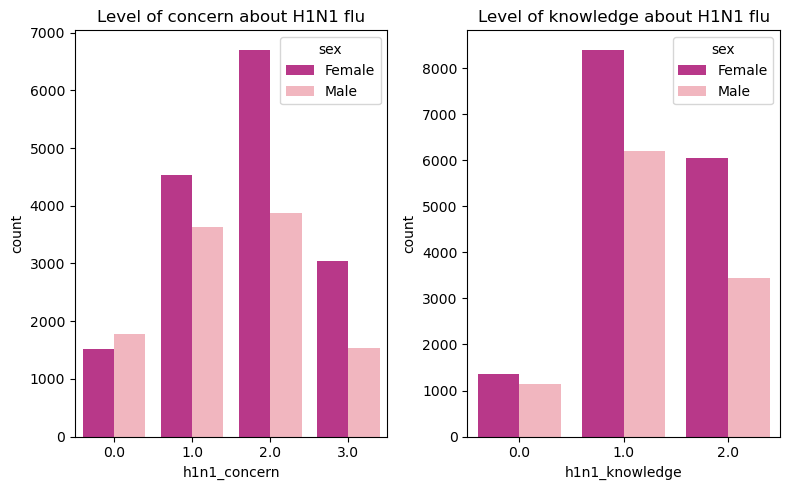

In [40]:
fig,axes = plt.subplots(ncols=2, figsize=(8,5))

sns.countplot(x='h1n1_concern', data = training, ax=axes[0], hue='sex', palette='RdPu_r')
sns.countplot(x='h1n1_knowledge', data = training, ax=axes[1], hue='sex', palette='RdPu_r')

fig.subplots_adjust(wspace=0.6)

axes[0].set_title('Level of concern about H1N1 flu')
axes[1].set_title('Level of knowledge about H1N1 flu')

plt.tight_layout()
plt.show()

**- Doctors Recommended H1N1 and Seasonal Flu Vaccine**

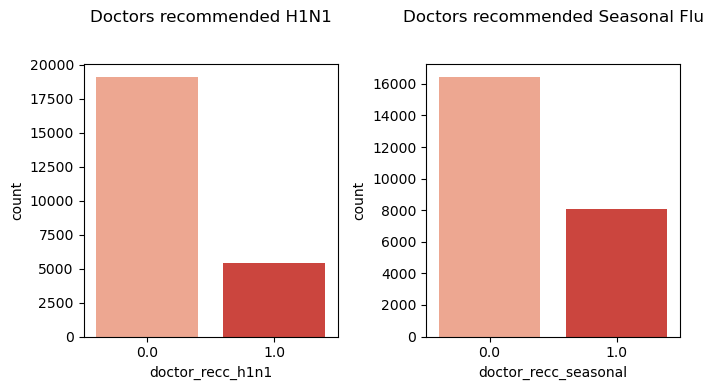

In [41]:
fig,axes = plt.subplots(ncols=2, figsize=(7,4))

sns.countplot(x='doctor_recc_h1n1', data = training, ax=axes[0], palette='Reds')
sns.countplot(x='doctor_recc_seasonal', data = training, ax=axes[1],palette='Reds')

fig.subplots_adjust(wspace=0.6)

axes[0].set_title('Doctors recommended H1N1', pad=30)
axes[1].set_title('Doctors recommended Seasonal Flu', pad=30)

plt.tight_layout()
plt.show()

**- People having Chronic Medical Condition by SEX**

<AxesSubplot:xlabel='chronic_med_condition', ylabel='count'>

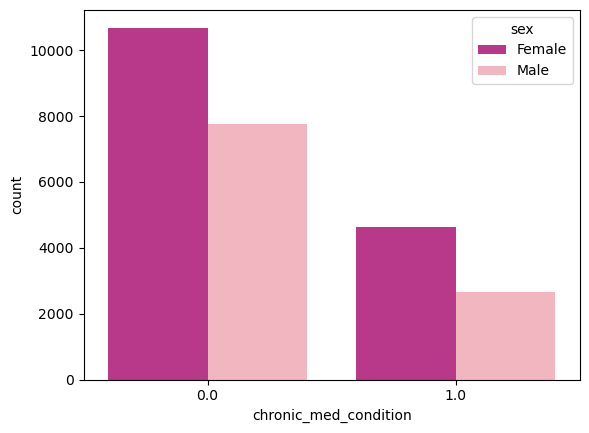

In [42]:
sns.countplot(x='chronic_med_condition', data = training, hue='sex', palette='RdPu_r')

**- Chronic Medical Condition by 'Age Group'**

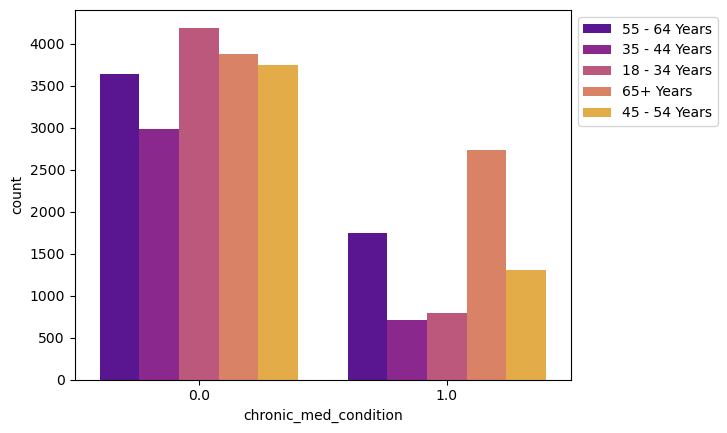

In [43]:
sns.countplot(x='chronic_med_condition', data = training, hue='age_group', palette='plasma')
plt.legend(bbox_to_anchor = (1,1), loc = 'upper left')

**- Comparing respondent's worry of getting SICK from taking 'H1N1' and 'Seasonal Flu' vaccine**

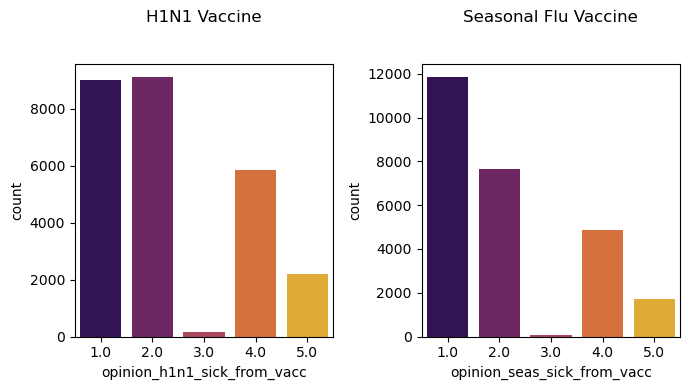

In [44]:
fig,axes = plt.subplots(ncols=2, figsize=(7,4))

sns.countplot(x='opinion_h1n1_sick_from_vacc', data = training, ax=axes[0], palette='inferno')
sns.countplot(x='opinion_seas_sick_from_vacc', data = training, ax=axes[1], palette='inferno')

fig.subplots_adjust(wspace=0.6)

axes[0].set_title('H1N1 Vaccine', pad=30)
axes[1].set_title('Seasonal Flu Vaccine', pad=30)
plt.tight_layout()
plt.show()

**- Comparing respondent's opinion about RISK of getting sick with 'H1N1' and 'Seasonal flu' without vaccine**

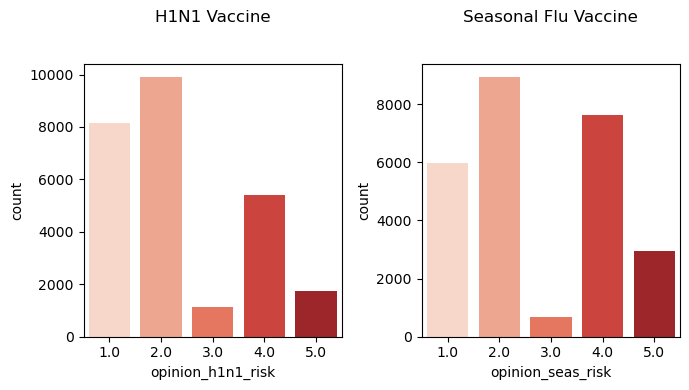

In [45]:
fig,axes = plt.subplots(ncols=2, figsize=(7,4))

sns.countplot(x='opinion_h1n1_risk', data = training, ax=axes[0], palette='Reds')
sns.countplot(x='opinion_seas_risk', data = training, ax=axes[1], palette='Reds')


axes[0].set_title('H1N1 Vaccine', pad=30)
axes[1].set_title('Seasonal Flu Vaccine', pad=30)

plt.tight_layout()
plt.show()

**- Comparing respondent's opinion about 'H1N1' and 'Seasonal Flu' vaccine EFFECTIVENESS**

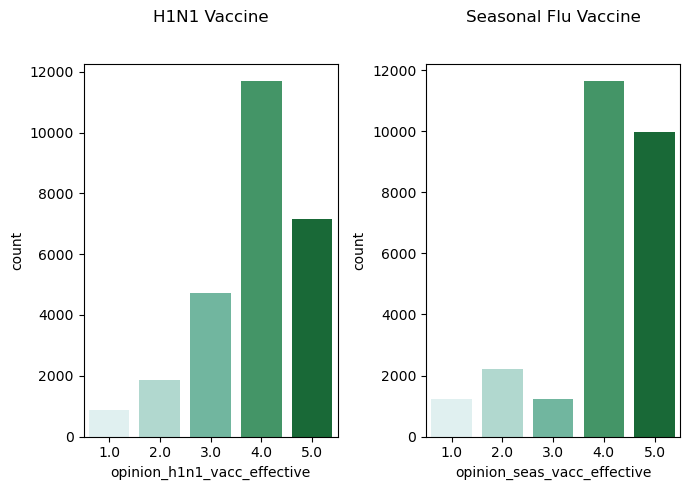

In [46]:
fig,axes = plt.subplots(ncols=2, figsize=(7,5))

sns.countplot(x='opinion_h1n1_vacc_effective', data = training, ax=axes[0], palette='BuGn')
sns.countplot(x='opinion_seas_vacc_effective', data = training, ax=axes[1], palette='BuGn')

axes[0].set_title('H1N1 Vaccine', pad=30)
axes[1].set_title('Seasonal Flu Vaccine', pad=30)

plt.tight_layout()
plt.show()

**- Comparing Number of Household 'Adults' and 'Children'**

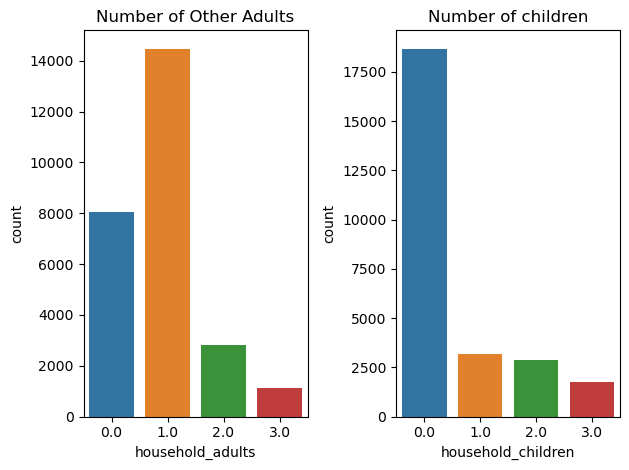

In [47]:
fig,axes = plt.subplots(ncols=2)

sns.countplot(data=training, x='household_adults', ax=axes[0])
sns.countplot(data=training, x='household_children', ax=axes[1])

fig.subplots_adjust(wspace=0.6)

axes[0].set_title('Number of Other Adults')
axes[1].set_title('Number of children')

plt.tight_layout()
plt.show()

**- Comparing 'Employment Status' and 'Income Poverty Level'**

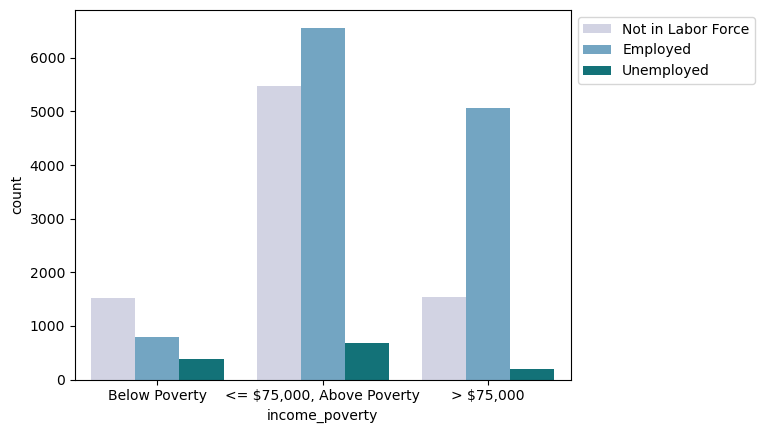

In [48]:
sns.countplot(hue = "employment_status", x = "income_poverty", data=training, palette = 'PuBuGn')
plt.legend(bbox_to_anchor = (1,1), loc = 'upper left')

**- Comparing the 'Employment Status' and 'Health Insurance'**

<AxesSubplot:xlabel='health_insurance', ylabel='count'>

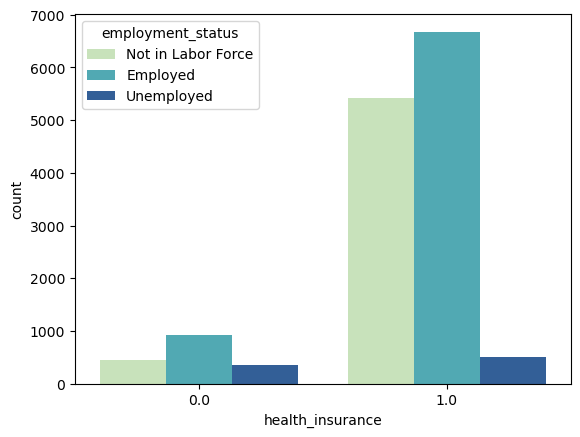

In [49]:
sns.countplot(hue="employment_status", x="health_insurance", data=training, palette='YlGnBu')

**- Comparing 'Housing Situation' of respondent's Income Category'**

<AxesSubplot:xlabel='income_poverty', ylabel='count'>

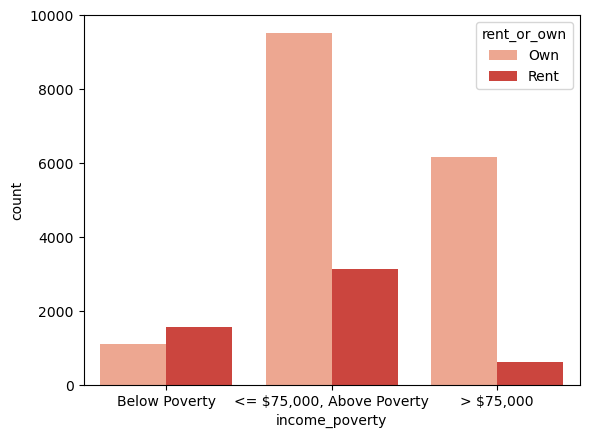

In [50]:
sns.countplot(x='income_poverty', data=training, hue='rent_or_own', palette='Reds')

**- Correlation Plot** 

<AxesSubplot:>

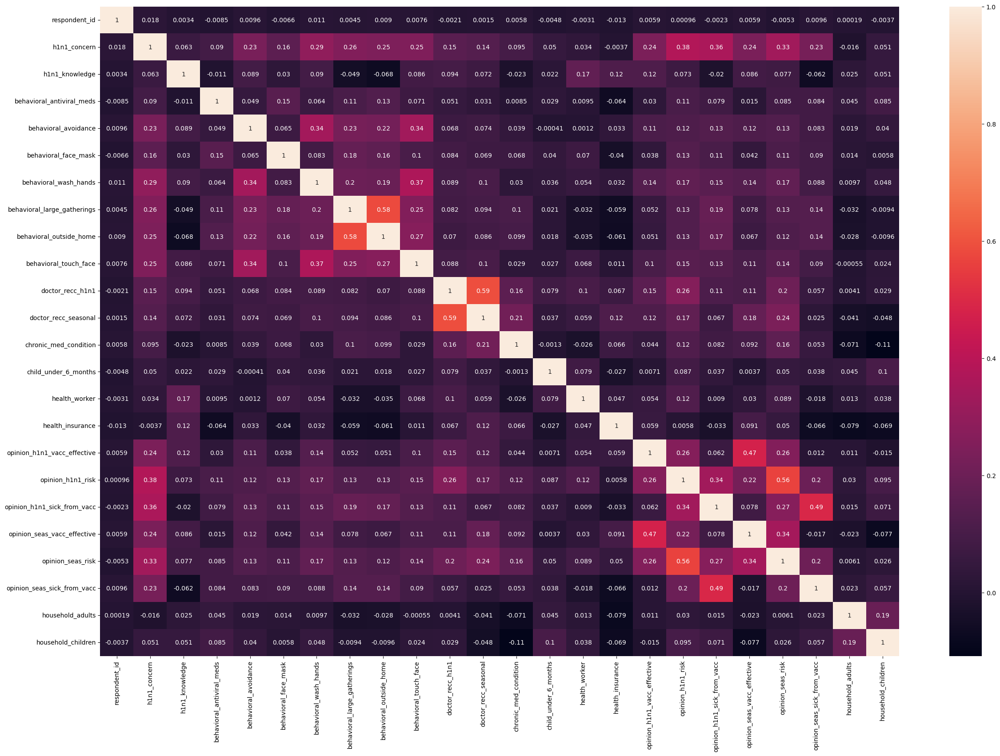

In [51]:
plt.figure(figsize=(29,19))
sns.heatmap(training.corr(),annot=True)

**- Combining all the Behavioural and creating overall_behaviour_score**

In [52]:
training_behaviour = training.copy()

In [53]:
training_behaviour['overall_behaviour_score'] = training_behaviour['behavioral_antiviral_meds'] + \
training_behaviour['behavioral_avoidance'] + training_behaviour['behavioral_face_mask'] + \
training_behaviour['behavioral_wash_hands'] + training_behaviour['behavioral_large_gatherings'] + \
training_behaviour['behavioral_outside_home'] + training_behaviour['behavioral_touch_face']

**- Checking the distribution for overall behaviour score**

/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='overall_behaviour_score', ylabel='Density'>

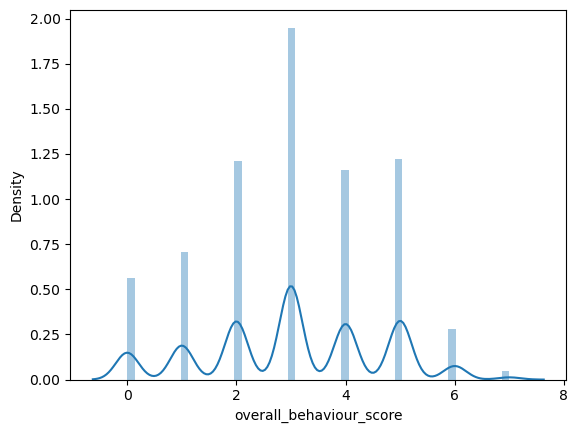

In [54]:
sns.distplot(training_behaviour['overall_behaviour_score'])

**- Comparing the behavioural score**

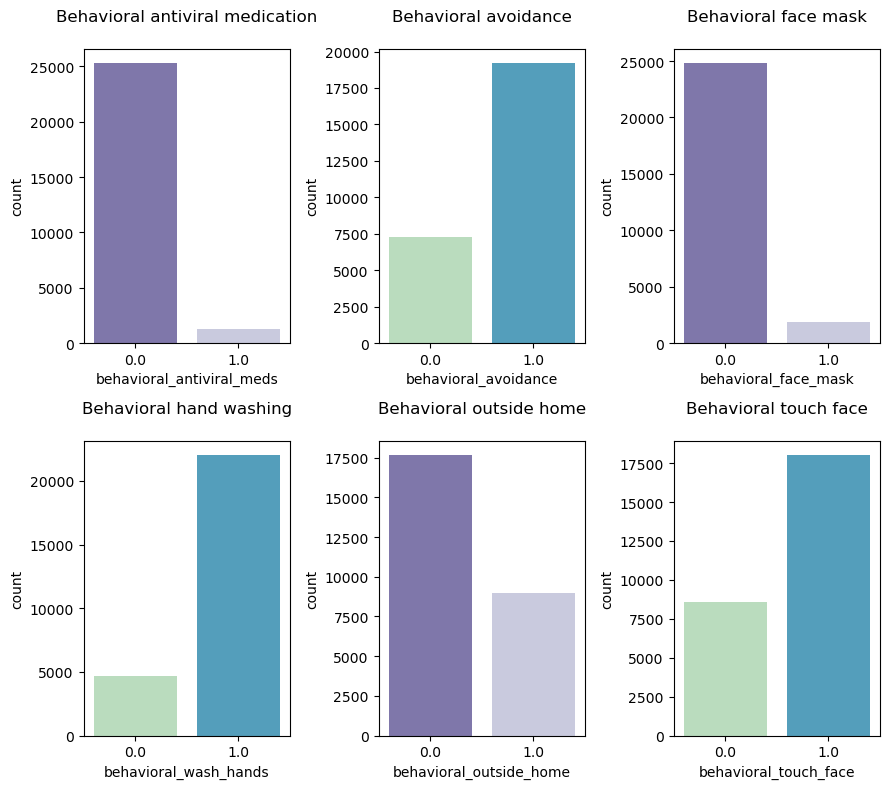

In [55]:
fig,axes = plt.subplots(nrows=2, ncols=3, figsize=(9,8))

sns.countplot(x='behavioral_antiviral_meds', data = training, ax=axes[0,0], palette='Purples_r')
sns.countplot(x='behavioral_avoidance', data = training, ax=axes[0,1], palette='GnBu')
sns.countplot(x='behavioral_face_mask', data = training, ax=axes[0,2],palette='Purples_r')
sns.countplot(x='behavioral_wash_hands', data = training, ax=axes[1,0], palette='GnBu')
sns.countplot(x='behavioral_outside_home', data = training, ax=axes[1,1], palette='Purples_r')
sns.countplot(x='behavioral_touch_face', data = training, ax=axes[1,2], palette='GnBu')

fig.subplots_adjust( wspace=0.4)


axes[0,0].set_title('Behavioral antiviral medication', pad=20)
axes[0,1].set_title('Behavioral avoidance', pad=20)
axes[0,2].set_title('Behavioral face mask', pad=20)
axes[1,0].set_title('Behavioral hand washing', pad=20)
axes[1,1].set_title('Behavioral outside home', pad=20)
axes[1,2].set_title('Behavioral touch face', pad=20)


plt.tight_layout()

plt.show()

<font size="5">Exploring Missing Data</font>

**- Checking the Total Number of Missing Value**

In [56]:
training.isnull().sum() 

respondent_id                      0
h1n1_concern                      92
h1n1_knowledge                   116
behavioral_antiviral_meds         71
behavioral_avoidance             208
behavioral_face_mask              19
behavioral_wash_hands             42
behavioral_large_gatherings       87
behavioral_outside_home           82
behavioral_touch_face            128
doctor_recc_h1n1                2160
doctor_recc_seasonal            2160
chronic_med_condition            971
child_under_6_months             820
health_worker                    804
health_insurance               12274
opinion_h1n1_vacc_effective      391
opinion_h1n1_risk                388
opinion_h1n1_sick_from_vacc      395
opinion_seas_vacc_effective      462
opinion_seas_risk                514
opinion_seas_sick_from_vacc      537
age_group                          0
education                       1407
race                               0
sex                                0
income_poverty                  4423
m

**- Creating a Function which returns Missing Value which is above zero in percentage**

In [57]:
def percentage_missing(training):
    
    percent_nan = 100 * training.isnull().sum() / len(training)
    percent_nan = percent_nan[percent_nan > 0].sort_values() 
    
    return percent_nan

In [58]:
percentage_nan = percentage_missing(training)

In [59]:
percentage_nan

behavioral_face_mask            0.071142
behavioral_wash_hands           0.157262
behavioral_antiviral_meds       0.265848
behavioral_outside_home         0.307036
behavioral_large_gatherings     0.325757
h1n1_concern                    0.344479
h1n1_knowledge                  0.434343
behavioral_touch_face           0.479275
behavioral_avoidance            0.778822
household_children              0.932340
household_adults                0.932340
opinion_h1n1_risk               1.452803
opinion_h1n1_vacc_effective     1.464036
opinion_h1n1_sick_from_vacc     1.479013
opinion_seas_vacc_effective     1.729884
opinion_seas_risk               1.924589
opinion_seas_sick_from_vacc     2.010709
health_worker                   3.010447
child_under_6_months            3.070356
chronic_med_condition           3.635751
education                       5.268282
marital_status                  5.272026
employment_status               5.477965
rent_or_own                     7.645936
doctor_recc_h1n1

**- Visualisation which represents the missing value percenatge for the Features**

Text(0, 0.5, 'Percentage of missing values')

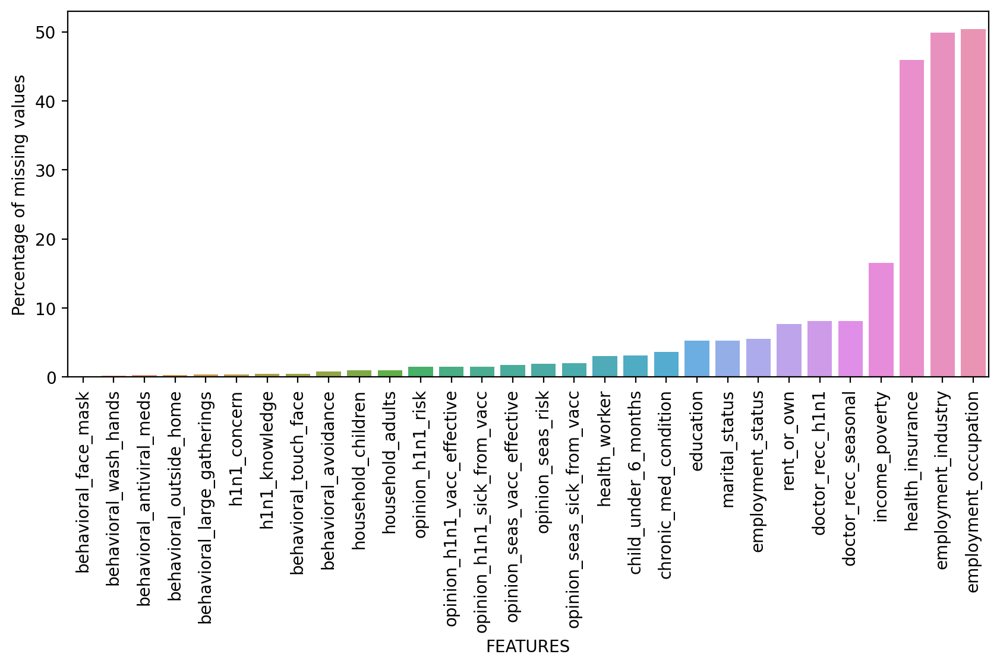

In [60]:
plt.figure(figsize=(10,4), dpi=200)

sns.barplot(x = percentage_nan.index, y = percentage_nan)

plt.xticks(rotation=90)

plt.xlabel('FEATURES')
plt.ylabel('Percentage of missing values')

**- Heatmaps for Analysing Missing Value Patterns**

- From the Heatmap, we can clearly identify some <u>patterns</u> in missing value.

In [61]:
Missing_value_heatmap = px.imshow(training.isnull(), color_continuous_scale='Purples')

Missing_value_heatmap.show()

<font size="3">Checking Categorical Missing Data</font>

**- Checking Missing values for Employment Occupation and Industry Data for Unemployed respondents.** 

- People who are unemployed will have NaN value in employment industry and occupation. As it is understood that these features are not applicable to the respondents which is also confirmed by CDC Quetsionare[1].

In [62]:
training[training["employment_status"]=="Unemployed"][["employment_industry",
                                                                     "employment_occupation"]].isna().sum()

employment_industry      1453
employment_occupation    1453
dtype: int64

**- Checking Missing values for Employment Occupation and Industry Data for 'Not in Labor Force'.** 
- People who are 'Not in Labor Force' will have NaN value in employment industry and occupation. As it is understood that these features are not applicable to the respondents which is also confirmed by CDC Quetsionare[1].

In [63]:
training[training["employment_status"]=="Not in Labor Force"][["employment_industry",
                                                                     "employment_occupation"]].isna().sum()

employment_industry      10231
employment_occupation    10231
dtype: int64

**- Checking Missing values for Employment Occupation and Industry Data for 'Employed People'.**
- Some people who are Employed but still, they have NaN values in the employment industry and occupation. Assuming the respondent has refused to answer this question which was confirmed by CDC Questionare[1].

In [64]:
training[training["employment_status"]=="Employed"][["employment_industry",
                                                           "employment_occupation"]].isna().sum()

employment_industry      183
employment_occupation    323
dtype: int64

<font size="5">Missing Value Imputation for Categorical Data</font> 

**- By : Karthikeyan & Adarsh**

In [65]:
training[category_columns].isna().sum()

race                         0
sex                          0
marital_status            1408
rent_or_own               2042
hhs_geo_region               0
census_msa                   0
employment_industry      13330
employment_occupation    13470
dtype: int64

**- Imputing Missing Value for 'employment_occupation'**

- Assigning missing values for employment_occupation with appropiate imputaion corresponding to their employment status.

In [66]:
for i, row in training[training['employment_occupation'].isna()].iterrows():
    conditions = (training["employment_status"]=="Unemployed")
    if conditions.any():
        training.loc[i, 'employment_occupation'] = 'unemployed_occupation'

In [67]:
for i, row in training[training['employment_occupation'].isna()].iterrows():
    conditions = (training["employment_status"]=="Not in Labor Force")
    if conditions.any():
        training.loc[i, 'employment_occupation'] = 'Not_in_laborforce'

In [68]:
for i, row in training[training['employment_occupation'].isna()].iterrows():
    conditions = (training["employment_status"]=="Employed")
    if conditions.any():
        training.loc[i, 'employment_occupation'] = 'other_occupation'

**- Imputing Missing Value for 'employment_industry'**
- Assigning missing values for employment_industry with appropiate imputaion corresponding to their employment status.

In [69]:
for i, row in training[training['employment_industry'].isna()].iterrows():
    conditions = (training["employment_status"]=="Unemployed")
    if conditions.any():
        training.loc[i, 'employment_industry'] = 'unemployed_in_industry'

In [70]:
for i, row in training[training['employment_industry'].isna()].iterrows():
    conditions = (training["employment_status"]=="Not in Labor Force")
    if conditions.any():
        training.loc[i, 'employment_industry'] = 'Not_in_laborforce'

In [71]:
for i, row in training[training['employment_industry'].isna()].iterrows():
    conditions = (training["employment_status"]=="Employed")
    if conditions.any():
        training.loc[i, 'employment_industry'] = 'other_industry'

**- Imputing Missing Values for 'income_poverty', 'marital_status', 'employment_status', 'rent_or_own' and 'education'.**

- According to CDC Questionare, marital_status and employment_status has options for refused and other category, income_poverty and education has other options such as refused and unknown and rent_or_own has other options such as other and refused.
<br>

    - Assigning missing values for the above columns with appropiate imputaion

In [72]:
income_poverty_nan = 'refused_or_unknown'
marital_status_nan = 'refused_or_other_category'
employment_status_nan = 'refused_or_other_category'
rent_or_own_nan = 'other_or_refused'
education_nan = 'refused_or_unknown'


training['income_poverty'].fillna(income_poverty_nan, inplace=True)
training['marital_status'].fillna(marital_status_nan, inplace=True)
training['employment_status'].fillna(employment_status_nan, inplace=True)
training['rent_or_own'].fillna(rent_or_own_nan, inplace=True)
training['education'].fillna(education_nan, inplace=True)

In [73]:
training[category_columns].isna().sum()

race                     0
sex                      0
marital_status           0
rent_or_own              0
hhs_geo_region           0
census_msa               0
employment_industry      0
employment_occupation    0
dtype: int64

**- Categories without Encoding for CatBoost**

In [74]:
training_minus_cat = training.copy()

<font size="5">Encoding Categorical Data</font> <u>-by : Karthikeyan & Adarsh</u>
<br>

**- As we don't want to encode numeric data, we will be encoding Categorical data first and missing value imputation part will be done later.**

In [75]:
le = LabelEncoder()

- Encoding Ordinal Columns

In [76]:
for features in ordinal_columns:
    training[features] = le.fit_transform(training[features])

In [77]:
training[ordinal_columns].head()

,age_group,education,income_poverty,employment_status
0,3,1,2,1
1,1,0,2,0
2,0,2,0,0
3,4,0,2,1
4,2,3,0,0


- Encoding Category Columns

In [78]:
training = pd.get_dummies(training, columns=category_columns, drop_first=True)

In [79]:
training.head()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,...,employment_occupation_rcertsgn,employment_occupation_tfqavkke,employment_occupation_ukymxvdu,employment_occupation_unemployed_occupation,employment_occupation_uqqtjvyb,employment_occupation_vlluhbov,employment_occupation_xgwztkwe,employment_occupation_xqwwgdyp,employment_occupation_xtkaffoo,employment_occupation_xzmlyyjv
0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,0,0,0,1,0,0,0,0,0,0
1,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,...,0,0,0,0,0,0,1,0,0,0
2,2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,1,0
3,3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,...,0,0,0,1,0,0,0,0,0,0
4,4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,0,0,0,0,0,0,0,0,0,0


<font size="5">Dealing Misssing Values in Numeric Data</font> 



 **NaN and -1 imputation**

In [80]:
training[numeric_columns].isna().sum()

respondent_id                      0
h1n1_concern                      92
h1n1_knowledge                   116
behavioral_antiviral_meds         71
behavioral_avoidance             208
behavioral_face_mask              19
behavioral_wash_hands             42
behavioral_large_gatherings       87
behavioral_outside_home           82
behavioral_touch_face            128
doctor_recc_h1n1                2160
doctor_recc_seasonal            2160
chronic_med_condition            971
child_under_6_months             820
health_worker                    804
health_insurance               12274
opinion_h1n1_vacc_effective      391
opinion_h1n1_risk                388
opinion_h1n1_sick_from_vacc      395
opinion_seas_vacc_effective      462
opinion_seas_risk                514
opinion_seas_sick_from_vacc      537
household_adults                 249
household_children               249
dtype: int64

- Creating New DataFrame for the appropiate imputation 
<br>

    - <b>training_minus</b> :"-1" is imputed for missing values.
    
    - <b>training_minus_cat</b> : "-1" is imputed for missing value.
    
    - <b>training_NaN</b> : This DataFrame has "NaN" for missing values.

In [81]:
training_minus = training.copy()
training_NaN = training.copy()

- Imputing missing values

In [82]:
training_minus.fillna(value = -1, inplace=True)
training_minus_cat.fillna(value = -1, inplace=True)

- Again Checking for Missing Value

In [83]:
training_minus.isna().sum()

respondent_id                     0
h1n1_concern                      0
h1n1_knowledge                    0
behavioral_antiviral_meds         0
behavioral_avoidance              0
                                 ..
employment_occupation_vlluhbov    0
employment_occupation_xgwztkwe    0
employment_occupation_xqwwgdyp    0
employment_occupation_xtkaffoo    0
employment_occupation_xzmlyyjv    0
Length: 91, dtype: int64

- Good to Go!

<font size="5">Preparing Logistic Regression</font> 

In [84]:
label = pd.read_csv('training_set_labels.csv')

In [85]:
data_minus = pd.merge(training_minus, label, on='respondent_id')

In [86]:
data_minus.drop('respondent_id', axis=1)

,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,doctor_recc_h1n1,...,employment_occupation_ukymxvdu,employment_occupation_unemployed_occupation,employment_occupation_uqqtjvyb,employment_occupation_vlluhbov,employment_occupation_xgwztkwe,employment_occupation_xqwwgdyp,employment_occupation_xtkaffoo,employment_occupation_xzmlyyjv,h1n1_vaccine,seasonal_vaccine
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,...,0,1,0,0,0,0,0,0,0,0
1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,...,0,0,0,0,1,0,0,0,0,1
2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,-1.0,...,0,0,0,0,0,0,1,0,0,0
3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,...,0,1,0,0,0,0,0,0,0,1
4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26702,2.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0,1,0,0,0,0,0,0,0,0
26703,1.0,2.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0,0,0,0,0,0,0,0,0,0
26704,2.0,2.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,...,0,1,0,0,0,0,0,0,0,1
26705,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.0,0.0,...,0,0,0,0,0,0,0,0,0,0


In [87]:
X = data_minus.drop(['h1n1_vaccine','seasonal_vaccine'],axis=1)

In [88]:
y1 = data_minus[['h1n1_vaccine']]

In [89]:
y2 = data_minus[['seasonal_vaccine']]

In [90]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y1, test_size=0.2, random_state=101)

In [91]:
scaler = StandardScaler()

In [92]:
scaled_X_train1 = scaler.fit_transform(X_train1)

scaled_X_test1 = scaler.transform(X_test1)

In [93]:
LR_model_h1n1 = LogisticRegression()

In [94]:
LR_model_h1n1.fit(scaled_X_train1, y_train1.values.ravel())

LogisticRegression()

In [95]:
LR_pred_h1n1 = LR_model_h1n1.predict(scaled_X_test1)

In [96]:
cm_h1n1 = confusion_matrix(y_test1, LR_pred_h1n1)
print(cm_h1n1)

[[3996  203]
 [ 619  524]]


In [97]:
print(classification_report(y_test1, LR_pred_h1n1))

              precision    recall  f1-score   support

           0       0.87      0.95      0.91      4199
           1       0.72      0.46      0.56      1143

    accuracy                           0.85      5342
   macro avg       0.79      0.71      0.73      5342
weighted avg       0.83      0.85      0.83      5342



In [98]:
LR_acuuracy_h1n1 = accuracy_score(y_test1, LR_pred_h1n1)

LR_acuuracy_h1n1

0.8461250467989517

In [99]:
pred_proba_h1n1 = LR_model_h1n1.predict_proba(scaled_X_test1)[:, 1]

auc_roc_h1n1 = roc_auc_score(y_test1, pred_proba_h1n1)

print('AUC-ROC score for LR model H1n1 vaccine:', auc_roc_h1n1)

AUC-ROC score for LR model H1n1 vaccine: 0.8441875820535532


In [100]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y2, test_size=0.2, random_state=101)

In [101]:
scaler = StandardScaler()

scaled_X_train2 = scaler.fit_transform(X_train2)
scaled_X_test2 = scaler.transform(X_test2)

In [102]:
LR_model_seasonal = LogisticRegression()

In [103]:
LR_model_seasonal.fit(scaled_X_train2, y_train2.values.ravel())

LogisticRegression()

In [104]:
LR_pred_seasonal = LR_model_seasonal.predict(scaled_X_test2)

In [105]:
cm2 = confusion_matrix(y_test2, LR_pred_seasonal)
print(cm2)

[[2281  542]
 [ 701 1818]]


In [106]:
print(classification_report(y_test2, LR_pred_seasonal))

              precision    recall  f1-score   support

           0       0.76      0.81      0.79      2823
           1       0.77      0.72      0.75      2519

    accuracy                           0.77      5342
   macro avg       0.77      0.76      0.77      5342
weighted avg       0.77      0.77      0.77      5342



In [107]:
LR_acuuracy_seasonal = accuracy_score(y_test2, LR_pred_seasonal)

LR_acuuracy_seasonal

0.7673156121302883

In [108]:
pred_proba_seasonal = LR_model_seasonal.predict_proba(scaled_X_test2)[:, 1] 
auc_roc_seasonal = roc_auc_score(y_test2, pred_proba_seasonal)

print("AUC-ROC score for LR model seasonal vaccine:", auc_roc_seasonal)

AUC-ROC score for LR model seasonal vaccine: 0.8397979113607289


In [109]:
from scipy.stats import uniform
from sklearn.model_selection import RandomizedSearchCV

In [110]:
solver_combinations = {
    'newton-cg': {'penalty': ['l2', 'none'],
                  'C': uniform(loc=0, scale=4)},
    'sag':       {'penalty': ['l2', 'none'],
                  'C': uniform(loc=0, scale=4)},
    'saga':      {'penalty': ['l1', 'l2', 'elasticnet', 'none'],
                  'C': uniform(loc=0, scale=4)},
}

best_score = -1
best_params = None
LR_model_h1n1_tuned = None

In [111]:
for solver, combination in solver_combinations.items():
    param_dist = {
        **combination,
        'solver': [solver],
        'fit_intercept': [True, False],
        'tol': [1e-4, 1e-5, 1e-6],
    }
    
    if solver == 'saga' and 'elasticnet' in combination['penalty']:
        param_dist['l1_ratio'] = [0.1, 0.3, 0.5, 0.7, 0.9]

    randomized_search = RandomizedSearchCV(LR_model_h1n1, param_dist, n_iter=100, cv=5, n_jobs=-1, 
                                           scoring='roc_auc', verbose=1, random_state=42)
    randomized_search.fit(scaled_X_train1, y_train1.values.ravel())
    
    if randomized_search.best_score_ > best_score:
        best_score = randomized_search.best_score_
        best_params = randomized_search.best_params_
        LR_model_h1n1_tuned = randomized_search.best_estimator_


Fitting 5 folds for each of 100 candidates, totalling 500 fits


/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/o

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/o

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1476: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1476: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1476: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio 

In [112]:
print("Best hyperparameters:", best_params)

Best hyperparameters: {'C': 0.5636968998990506, 'fit_intercept': True, 'l1_ratio': 0.9, 'penalty': 'l1', 'solver': 'saga', 'tol': 0.0001}


In [113]:
LR_pred_h1n1_tuned = LR_model_h1n1_tuned.predict(scaled_X_test1)

In [114]:
LR_acuuracy_h1n1_tuned = accuracy_score(y_test1, LR_pred_h1n1_tuned)

In [115]:
LR_acuuracy_h1n1_tuned

0.8461250467989517

In [116]:
pred_proba_h1n1_tuned = LR_model_h1n1_tuned.predict_proba(scaled_X_test1)[:, 1]

auc_roc_h1n1_tuned = roc_auc_score(y_test1, pred_proba_h1n1_tuned)

print('AUC-ROC score for tuned LR model H1n1 vaccine:', auc_roc_h1n1_tuned)

AUC-ROC score for tuned LR model H1n1 vaccine: 0.8442438384175542


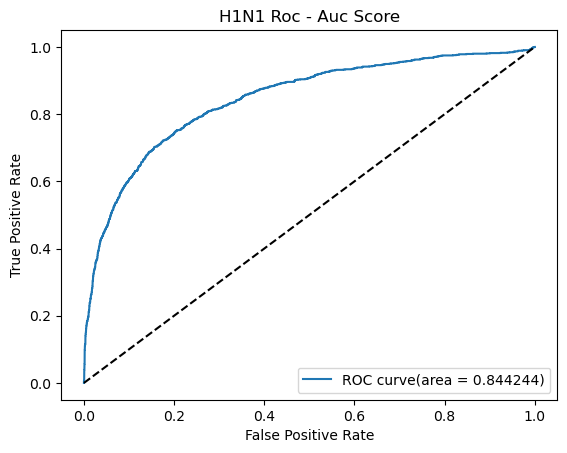

In [117]:
fpr, tpr, thresholds = roc_curve(y_test1, pred_proba_h1n1_tuned)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('H1N1 Roc - Auc Score')
plt.legend(loc="lower right")
plt.show()

In [118]:
best_score = -1
best_params = None
LR_model_seasonal_tuned = None

In [119]:
for solver, combination in solver_combinations.items():
    param_dist = {
        **combination,
        'solver': [solver],
        'fit_intercept': [True, False],
        'tol': [1e-4, 1e-5, 1e-6],
    }
    
    if solver == 'saga' and 'elasticnet' in combination['penalty']:
        param_dist['l1_ratio'] = [0.1, 0.3, 0.5, 0.7, 0.9]

    randomized_search = RandomizedSearchCV(LR_model_seasonal, param_dist, n_iter=100, cv=5, n_jobs=-1, 
                                           scoring='roc_auc', verbose=1, random_state=42)
    randomized_search.fit(scaled_X_train2, y_train2.values.ravel())
    
    if randomized_search.best_score_ > best_score:
        best_score = randomized_search.best_score_
        best_params = randomized_search.best_params_
        LR_model_seasonal_tuned = randomized_search.best_estimator_

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/_linesearch.py:305: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/o

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:352: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Users/karthikeyan/o

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1476: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1476: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (penalty=none)
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1483: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:1476: UserWarning: l1_ratio parameter is only used when penalty is 'elasticnet'. Got (pen

In [120]:
LR_pred_seasonal_tuned = LR_model_seasonal_tuned.predict(scaled_X_test2)

In [121]:
LR_acuuracy_seasonal_tuned = accuracy_score(y_test2, LR_pred_seasonal_tuned)

In [122]:
LR_acuuracy_seasonal_tuned

0.7673156121302883

In [123]:
pred_proba_seasonal_tuned = LR_model_seasonal_tuned.predict_proba(scaled_X_test2)[:, 1]

auc_roc_seasonal_tuned = roc_auc_score(y_test2, pred_proba_seasonal_tuned)

print('AUC-ROC score for tuned LR model Seasonal Flu vaccine:', auc_roc_seasonal_tuned)

AUC-ROC score for tuned LR model Seasonal Flu vaccine: 0.8398069113279634


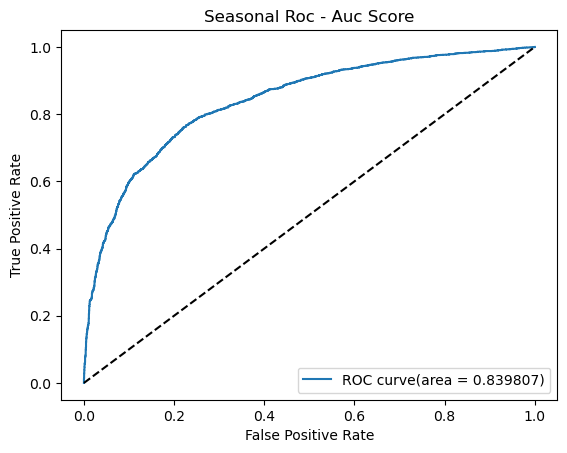

In [124]:
fpr, tpr, thresholds = roc_curve(y_test2, pred_proba_seasonal_tuned)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Seasonal Roc - Auc Score')
plt.legend(loc="lower right")
plt.show()

<font size="5">Prediction Using SVM</font>

In [125]:
training_mode_imputation = training.copy()

In [126]:
training_mode_imputation.fillna(training_mode_imputation.mode().iloc[0], inplace=True)

In [127]:
training_mode_imputation.isna().sum()

respondent_id                     0
h1n1_concern                      0
h1n1_knowledge                    0
behavioral_antiviral_meds         0
behavioral_avoidance              0
                                 ..
employment_occupation_vlluhbov    0
employment_occupation_xgwztkwe    0
employment_occupation_xqwwgdyp    0
employment_occupation_xtkaffoo    0
employment_occupation_xzmlyyjv    0
Length: 91, dtype: int64

In [128]:
df_mode = pd.merge(training_mode_imputation, label, on='respondent_id')

In [129]:
df_mode = df_mode.drop('respondent_id',axis=1)

In [130]:
X = df_mode.drop(['h1n1_vaccine','seasonal_vaccine'],axis=1)

In [131]:
y1 = df_mode['h1n1_vaccine']
y2 = df_mode['seasonal_vaccine']

In [132]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y1, test_size=0.2, random_state=101)

In [133]:
scaler = StandardScaler()

scaled_X_train1 = scaler.fit_transform(X_train1)

scaled_X_test1 = scaler.transform(X_test1)

In [134]:
svm_h1n1 = SVC()

svm_h1n1.fit(scaled_X_train1, y_train1.values.ravel())


svm_pred_h1n1 = svm_h1n1.predict(scaled_X_test1)


print(classification_report(y_test1, svm_pred_h1n1))

              precision    recall  f1-score   support

           0       0.85      0.95      0.90      4199
           1       0.69      0.38      0.49      1143

    accuracy                           0.83      5342
   macro avg       0.77      0.67      0.70      5342
weighted avg       0.82      0.83      0.81      5342



In [135]:
svm_acuuracy_h1n1 = accuracy_score(y_test1, svm_pred_h1n1)

svm_acuuracy_h1n1

0.8313365780606514

In [136]:
svm_decision_h1n1 = svm_h1n1.decision_function(scaled_X_test1)

auc_roc_h1n1 = roc_auc_score(y_test1, svm_decision_h1n1)

print('AUC-ROC score for tuned SVM H1n1 vaccine:', auc_roc_h1n1)

AUC-ROC score for tuned SVM H1n1 vaccine: 0.8080897484861309


In [137]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y2, test_size=0.2, random_state=101)

In [138]:
scaler = StandardScaler()

scaled_X_train2 = scaler.fit_transform(X_train2)

scaled_X_test2 = scaler.transform(X_test2)

In [139]:
svm_seasonal = SVC()

svm_seasonal.fit(scaled_X_train2, y_train2.values.ravel())

svm_pred_seasonal = svm_seasonal.predict(scaled_X_test2)

In [140]:
print(classification_report(y_test1, svm_pred_seasonal))

              precision    recall  f1-score   support

           0       0.88      0.64      0.74      4199
           1       0.34      0.69      0.46      1143

    accuracy                           0.65      5342
   macro avg       0.61      0.66      0.60      5342
weighted avg       0.77      0.65      0.68      5342



In [141]:
svm_acuuracy_seasonal = accuracy_score(y_test2, svm_pred_seasonal)

svm_acuuracy_seasonal

0.7675028079371022

In [142]:
svm_decision_seasonal = svm_seasonal.decision_function(scaled_X_test2)

auc_roc_seasonal = roc_auc_score(y_test2, svm_decision_seasonal)

print('AUC-ROC score for tuned SVM seasonal vaccine:', auc_roc_seasonal)

AUC-ROC score for tuned SVM seasonal vaccine: 0.8434149138175795


<font size="5">Prediction Using XGBoost</font> 

- Combining "training features" and "labels" as combined_df

In [143]:
combined_df = pd.merge(training_NaN, label, on='respondent_id')

- data will be the training features for XGB model and preparing train test split with 20% of testing data. The same test size and random seed will be used for both "H1N1" and "Seasonal" model.

In [144]:
data = combined_df.drop(['h1n1_vaccine', 'seasonal_vaccine', 'respondent_id'], axis=1)

In [145]:
X_train, X_test, y_train, y_test = train_test_split(data, y1, test_size=0.2, random_state=101)

**Preparing and Predicting "XGB model for H1N1" with Default Parameters**

In [146]:
XGB_h1 = XGBClassifier(missing=np.nan)

In [147]:
XGB_h1.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [148]:
XGB_predict_h1 = XGB_h1.predict(X_test)

**Evaluating "H1N1 model" <u>without hyperparameter tuning</u>**

In [149]:
print(classification_report(y_test, XGB_predict_h1))

              precision    recall  f1-score   support

           0       0.88      0.94      0.91      4199
           1       0.70      0.53      0.60      1143

    accuracy                           0.85      5342
   macro avg       0.79      0.73      0.75      5342
weighted avg       0.84      0.85      0.84      5342



In [150]:
h1_prediction_roc = XGB_h1.predict_proba(X_test)[:, 1]

roc_auc = roc_auc_score(y_test, h1_prediction_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8571238371340758


**Preparing and Predicting "XGB model for Seasonal" with Default Parameters**

In [151]:
X_train, X_test, y_train, y_test = train_test_split(data, y2, test_size=0.2, random_state=101)

In [152]:
XGB_seas = XGBClassifier(missing=np.nan)

In [153]:
XGB_seas.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [154]:
XGB_predict_seas = XGB_seas.predict(X_test)

**Evaluating "Seasonal model" <u>without hyperparameter tuning</u>**

In [155]:
print(classification_report(y_test, XGB_predict_seas))

              precision    recall  f1-score   support

           0       0.78      0.80      0.79      2823
           1       0.77      0.75      0.76      2519

    accuracy                           0.78      5342
   macro avg       0.78      0.77      0.78      5342
weighted avg       0.78      0.78      0.78      5342



In [156]:
seas_prediction_roc = XGB_seas.predict_proba(X_test)[:, 1]

roc_auc = roc_auc_score(y_test, seas_prediction_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8547784974470326


**- Hyperparameter Tuning using OPTUNA** 

In [160]:
X_train, X_test, y_train, y_test = train_test_split(data, y1,
                                                    test_size=0.2, random_state=101)


def objective(trial):
    param = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-8, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-8, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 6),
        'gamma': trial.suggest_float('gamma',1e-8, 1.0),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 0.8),
        'subsample': trial.suggest_float('subsample', 0.3, 0.8),
    }
    
    xgb = XGBClassifier(**param, missing= np.nan)
    
    from sklearn.model_selection import cross_val_score
    scores = cross_val_score(xgb, data, y1, cv=5, scoring='roc_auc')
    AUC = np.mean(scores).max() 
    return AUC

In [161]:
study_h1 = optuna.create_study(direction='maximize', sampler=TPESampler())
study_h1.optimize(objective, n_trials=120, show_progress_bar=True)

[I 2023-05-19 16:42:43,493] A new study created in memory with name: no-name-ceb921f0-b307-44d3-97d2-1bea3de341ac
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/optuna/progress_bar.py:56: ExperimentalWarning:

Progress bar is experimental (supported from v1.2.0). The interface can change in the future.



  0%|          | 0/120 [00:00<?, ?it/s]

[I 2023-05-19 16:43:24,716] Trial 0 finished with value: 0.8719592694925554 and parameters: {'n_estimators': 377, 'max_depth': 7, 'reg_alpha': 0.5455606119596196, 'reg_lambda': 0.04339918736678362, 'min_child_weight': 3, 'gamma': 0.4992942837313527, 'learning_rate': 0.01620837857827828, 'colsample_bytree': 0.6819822545244996, 'subsample': 0.6097452596437924}. Best is trial 0 with value: 0.8719592694925554.
[I 2023-05-19 16:43:40,872] Trial 1 finished with value: 0.7949221345557566 and parameters: {'n_estimators': 176, 'max_depth': 9, 'reg_alpha': 0.1911433266609178, 'reg_lambda': 0.7623334864901535, 'min_child_weight': 4, 'gamma': 0.5286819430514262, 'learning_rate': 0.6799735069115982, 'colsample_bytree': 0.34923456904090006, 'subsample': 0.49201890416139193}. Best is trial 0 with value: 0.8719592694925554.
[I 2023-05-19 16:44:11,161] Trial 2 finished with value: 0.8348532059899982 and parameters: {'n_estimators': 291, 'max_depth': 9, 'reg_alpha': 0.9941390944287669, 'reg_lambda': 0.8

**- H1N1 Best params**

In [162]:
study_h1.best_trial       # Best trial with best parameters

FrozenTrial(number=91, state=TrialState.COMPLETE, values=[0.872275572166038], datetime_start=datetime.datetime(2023, 5, 19, 17, 44, 9, 370107), datetime_complete=datetime.datetime(2023, 5, 19, 17, 44, 45, 875303), params={'n_estimators': 357, 'max_depth': 6, 'reg_alpha': 0.9526373620859971, 'reg_lambda': 0.9172683413926652, 'min_child_weight': 2, 'gamma': 0.2081422299233378, 'learning_rate': 0.024063183390392665, 'colsample_bytree': 0.5774452981988635, 'subsample': 0.7173181656097279}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'n_estimators': IntDistribution(high=500, log=False, low=50, step=1), 'max_depth': IntDistribution(high=10, log=False, low=3, step=1), 'reg_alpha': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'reg_lambda': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'min_child_weight': IntDistribution(high=6, log=False, low=0, step=1), 'gamma': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'learning_

In [163]:
h1n1_param = study_h1.best_params

In [164]:
h1n1_param

{'n_estimators': 357,
 'max_depth': 6,
 'reg_alpha': 0.9526373620859971,
 'reg_lambda': 0.9172683413926652,
 'min_child_weight': 2,
 'gamma': 0.2081422299233378,
 'learning_rate': 0.024063183390392665,
 'colsample_bytree': 0.5774452981988635,
 'subsample': 0.7173181656097279}

In [165]:
study_h1.pruner

In [166]:
X_train, X_test, y_train, y_test = train_test_split(data, y2,
                                                    test_size=0.2, random_state=101)


def objective(trial):
    param = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-8, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-8, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 6),
        'gamma': trial.suggest_float('gamma',1e-8, 1.0),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 0.8),
        'subsample': trial.suggest_float('subsample', 0.3, 0.8),
    }
    
    xgb = XGBClassifier(**param, missing= np.nan)
    
    from sklearn.model_selection import cross_val_score
    scores = cross_val_score(xgb, data, y2, cv=5, scoring='roc_auc')
    AUC = np.mean(scores).max() 
    return AUC

In [167]:
study_seas = optuna.create_study(direction='maximize', sampler=TPESampler())
study_seas.optimize(objective, n_trials=120, show_progress_bar=True)

[I 2023-05-19 18:16:56,541] A new study created in memory with name: no-name-a6ef69a3-79e2-4401-a9d4-6d70ff8c04cf
/Users/karthikeyan/opt/anaconda3/lib/python3.9/site-packages/optuna/progress_bar.py:56: ExperimentalWarning:

Progress bar is experimental (supported from v1.2.0). The interface can change in the future.



  0%|          | 0/120 [00:00<?, ?it/s]

[I 2023-05-19 18:17:56,211] Trial 0 finished with value: 0.863423610226878 and parameters: {'n_estimators': 362, 'max_depth': 10, 'reg_alpha': 0.32763892173394854, 'reg_lambda': 0.9634616521463987, 'min_child_weight': 0, 'gamma': 0.8361322079184171, 'learning_rate': 0.014784623626949147, 'colsample_bytree': 0.5056460788233242, 'subsample': 0.7204181374620316}. Best is trial 0 with value: 0.863423610226878.
[I 2023-05-19 18:18:26,279] Trial 1 finished with value: 0.80469672054001 and parameters: {'n_estimators': 335, 'max_depth': 5, 'reg_alpha': 0.12196934151449897, 'reg_lambda': 0.9956366206034424, 'min_child_weight': 4, 'gamma': 0.9934180891396005, 'learning_rate': 0.6784787829573024, 'colsample_bytree': 0.7178251638397655, 'subsample': 0.5571743685057908}. Best is trial 0 with value: 0.863423610226878.
[I 2023-05-19 18:19:23,384] Trial 2 finished with value: 0.8570339558741191 and parameters: {'n_estimators': 451, 'max_depth': 7, 'reg_alpha': 0.9203761946378539, 'reg_lambda': 0.78460

In [168]:
study_seas.best_trial

FrozenTrial(number=63, state=TrialState.COMPLETE, values=[0.8660736685459369], datetime_start=datetime.datetime(2023, 5, 19, 18, 38, 20, 337325), datetime_complete=datetime.datetime(2023, 5, 19, 18, 38, 46, 83662), params={'n_estimators': 355, 'max_depth': 5, 'reg_alpha': 0.6025177173837138, 'reg_lambda': 0.7255655611590764, 'min_child_weight': 4, 'gamma': 0.23803836087384878, 'learning_rate': 0.044407830564428985, 'colsample_bytree': 0.4177399881065694, 'subsample': 0.7069118489410389}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'n_estimators': IntDistribution(high=500, log=False, low=50, step=1), 'max_depth': IntDistribution(high=10, log=False, low=3, step=1), 'reg_alpha': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'reg_lambda': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'min_child_weight': IntDistribution(high=6, log=False, low=0, step=1), 'gamma': FloatDistribution(high=1.0, log=False, low=1e-08, step=None), 'learnin

In [169]:
param_seasonal = study_seas.best_params

In [170]:
param_seasonal

{'n_estimators': 355,
 'max_depth': 5,
 'reg_alpha': 0.6025177173837138,
 'reg_lambda': 0.7255655611590764,
 'min_child_weight': 4,
 'gamma': 0.23803836087384878,
 'learning_rate': 0.044407830564428985,
 'colsample_bytree': 0.4177399881065694,
 'subsample': 0.7069118489410389}

In [171]:
study_seas.pruner

**- Preparing the "H1N1 model" for predicting using the best parameters.**

In [261]:
X_train_h1, X_test_h1, y_train_h1, y_test_h1 = train_test_split(data, y1,
                                                                test_size=0.2, random_state=101)

In [262]:
h1n1_model_tuned = XGBClassifier(**h1n1_param, missing = np.nan)

In [263]:
h1n1_model_tuned.fit(X_train_h1, y_train_h1)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.5774452981988635, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.2081422299233378, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.024063183390392665, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=None,
              min_child_weight=2, missing=nan, monotone_constraints=None,
              n_estimators=357, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [264]:
h1n1_predict_tuned = h1n1_model_tuned.predict(X_test_h1)

**- Evaluating the H1N1 model**

In [265]:
print(classification_report(y_test_h1, h1n1_predict_tuned))

              precision    recall  f1-score   support

           0       0.88      0.95      0.91      4199
           1       0.75      0.51      0.60      1143

    accuracy                           0.86      5342
   macro avg       0.81      0.73      0.76      5342
weighted avg       0.85      0.86      0.85      5342



In [266]:
h1_tuned_roc = h1n1_model_tuned.predict_proba(X_test_h1)[:, 1]

roc_auc = roc_auc_score(y_test_h1, h1_tuned_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8677521227922242


**- Preparing the "Seasonal Model" for predicting using the best parameters.**

In [252]:
X_train_seas, X_test_seas, y_train_seas, y_test_seas = train_test_split(data, y2, 
                                                                        test_size=0.2, random_state=101)

In [253]:
seasonal_model_tuned = XGBClassifier(**param_seasonal, missing= np.nan)

In [254]:
seasonal_model_tuned.fit(X_train_seas, y_train_seas)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.4177399881065694, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.23803836087384878, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.044407830564428985, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=4, missing=nan, monotone_constraints=None,
              n_estimators=355, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)

In [255]:
seas_predict_tuned = seasonal_model_tuned.predict(X_test_seas)

**- Evaluating the "Seasonal model".**

In [256]:
print(classification_report(y_test_seas, seas_predict_tuned))

              precision    recall  f1-score   support

           0       0.79      0.82      0.80      2823
           1       0.79      0.75      0.77      2519

    accuracy                           0.79      5342
   macro avg       0.79      0.79      0.79      5342
weighted avg       0.79      0.79      0.79      5342



In [257]:
seas_tuned_roc = seasonal_model_tuned.predict_proba(X_test_seas)[:, 1]

roc_auc = roc_auc_score(y_test_seas, seas_tuned_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8668577190961164


**- Plotting ROC Curve for H1N1 Vaccine.**

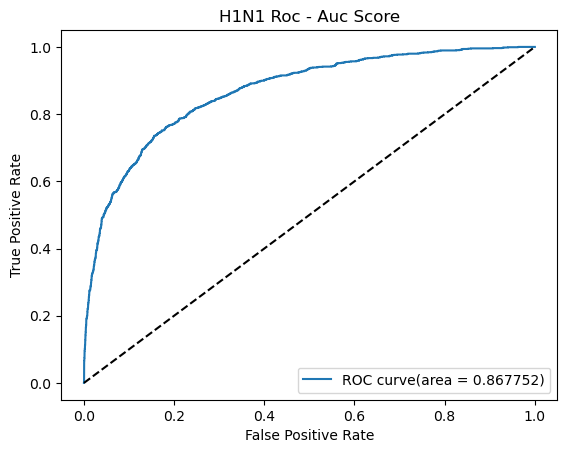

In [267]:
fpr, tpr, thresholds = roc_curve(y_test_h1, h1_tuned_roc)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('H1N1 Roc - Auc Score')
plt.legend(loc="lower right")
plt.show()

**- Plotting ROC Curve for Seasonal Vaccine.**

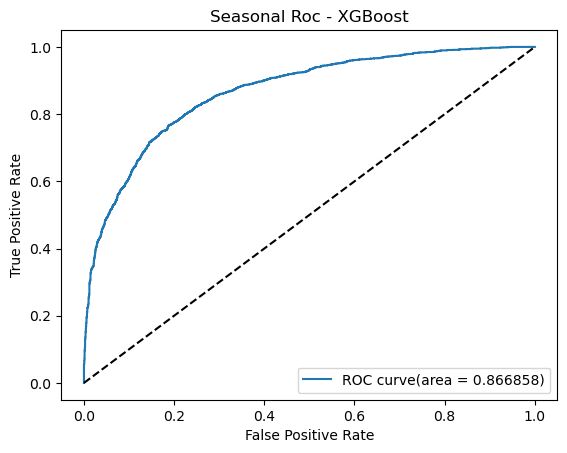

In [277]:
fpr, tpr, thresholds = roc_curve(y_test_seas, seas_tuned_roc)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Seasonal Roc - XGBoost')
plt.legend(loc="lower right")
plt.show()

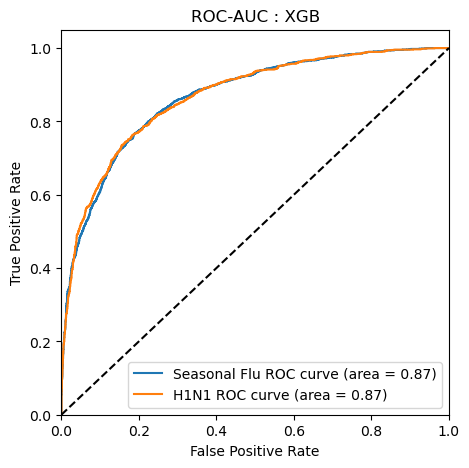

In [186]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt



models_dict = {"Seasonal Flu": (y_test_seas, seas_tuned_roc), "H1N1": (y_test_h1, h1_tuned_roc)} 
plt.figure(figsize=(5, 5))

for model_name, (y_test, y_score) in models_dict.items():
    fpr, tpr, _ = roc_curve(y_test, y_score)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label='{} ROC curve (area = {:.2f})'.format(model_name, roc_auc))


plt.plot([0, 1], [0, 1], 'k--')


plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC-AUC : XGB')
plt.legend(loc="lower right")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])


plt.show()

**- Checking the Feature Importance from XGB model for H1N1 vaccination.**

In [187]:
importance_scores_h1 = h1n1_model_tuned.get_booster().get_score(importance_type='weight')

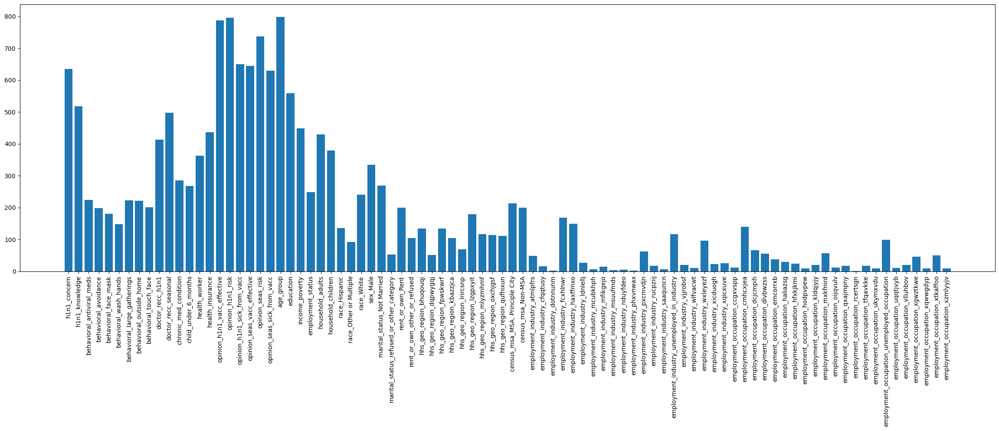

In [188]:
plt.figure(figsize=(29,8))
plt.bar(range(len(importance_scores_h1)), list(importance_scores_h1.values()),
        tick_label=list(importance_scores_h1.keys()))
plt.xticks(rotation=90)
plt.show()

**- Checking the Feature Importance from XGB model for Seasonal vaccination.**

In [189]:
importance_scores_seas = seasonal_model_tuned.get_booster().get_score(importance_type='weight')

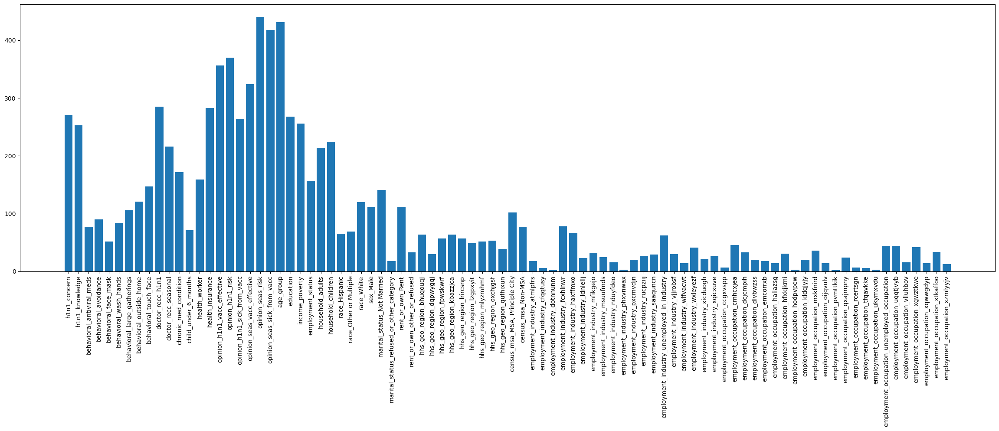

In [190]:
plt.figure(figsize=(29,8))
plt.bar(range(len(importance_scores_seas)), list(importance_scores_seas.values()),
        tick_label=list(importance_scores_seas.keys()))
plt.xticks(rotation=90)
plt.show()

<font size="5"> Predicting Probablility using CatBoost</font> 

- Since CatBoost takes more time to work, we used joblib and we are extracting information from the joblib.


    IMPORTANT Place the Joblib file and jupyter notebook should be in same directory.

In [191]:
import joblib

In [192]:
catBoost = joblib.load('H1_catBoost.joblib')

In [193]:
h1 = catBoost.get_params()

**- Importing best parameters from the trained model using joblib**

In [194]:
h1_params = {'iterations': 800,
 'learning_rate': 0.01763701383127006,
 'l2_leaf_reg': 17.4357146267731,
 'auto_class_weights': 'SqrtBalanced',
 'one_hot_max_size': 12,
 'random_strength': 5,
 'bagging_temperature': 1,
 'max_depth': 6,
 'max_bin': 10,
 'grow_policy': 'Depthwise',
 'min_data_in_leaf': 10}

**- Preparing CatBoost without encoding for H1N1**

In [195]:
X_train_h1, X_test_h1, y_train_h1, y_test_h1 = train_test_split( training_minus_cat,
                                                    y1, test_size=0.2, random_state=101)

In [196]:
categorical_features = np.where(X_train_h1.dtypes != float)[0]

In [197]:
from catboost import CatBoostClassifier

In [198]:
h1_cat_model = CatBoostClassifier(**h1_params, cat_features= categorical_features)

In [199]:
h1_cat_model.fit(X_train_h1, y_train_h1)

0:	learn: 0.6867346	total: 80.6ms	remaining: 1m 4s
1:	learn: 0.6798440	total: 95ms	remaining: 37.9s
2:	learn: 0.6735085	total: 110ms	remaining: 29.1s
3:	learn: 0.6677781	total: 127ms	remaining: 25.3s
4:	learn: 0.6623219	total: 140ms	remaining: 22.3s
5:	learn: 0.6562700	total: 157ms	remaining: 20.8s
6:	learn: 0.6499714	total: 172ms	remaining: 19.4s
7:	learn: 0.6451306	total: 186ms	remaining: 18.4s
8:	learn: 0.6391739	total: 201ms	remaining: 17.6s
9:	learn: 0.6335811	total: 215ms	remaining: 17s
10:	learn: 0.6297299	total: 230ms	remaining: 16.5s
11:	learn: 0.6254197	total: 244ms	remaining: 16s
12:	learn: 0.6202522	total: 258ms	remaining: 15.6s
13:	learn: 0.6160956	total: 274ms	remaining: 15.4s
14:	learn: 0.6123456	total: 290ms	remaining: 15.2s
15:	learn: 0.6078965	total: 306ms	remaining: 15s
16:	learn: 0.6035815	total: 321ms	remaining: 14.8s
17:	learn: 0.5999348	total: 335ms	remaining: 14.6s
18:	learn: 0.5965491	total: 348ms	remaining: 14.3s
19:	learn: 0.5924425	total: 362ms	remaining: 14

**- CatBoost Prediction and Evaluation for H1N1**

In [200]:
h1_cat_predict = h1_cat_model.predict(X_test_h1)

In [201]:
print(classification_report(y_test_h1, h1_cat_predict))

              precision    recall  f1-score   support

           0       0.90      0.90      0.90      4199
           1       0.63      0.62      0.63      1143

    accuracy                           0.84      5342
   macro avg       0.77      0.76      0.76      5342
weighted avg       0.84      0.84      0.84      5342



In [202]:
cat_model_roc = h1_cat_model.predict_proba(X_test_h1)[:, 1]

roc_auc = roc_auc_score(y_test_h1, cat_model_roc)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8681282070034173


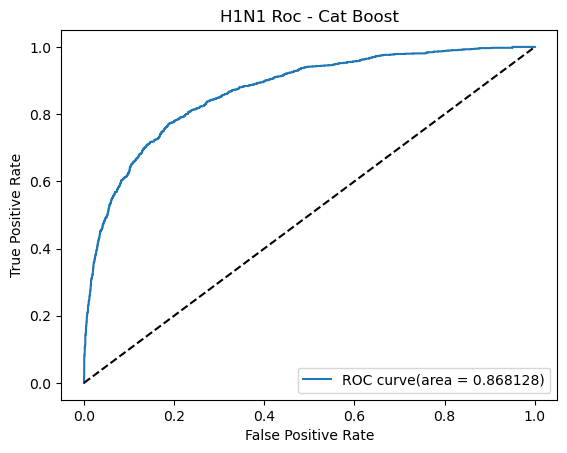

In [270]:
fpr, tpr, thresholds = roc_curve(y_test_h1, cat_model_roc)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('H1N1 Roc - Cat Boost')
plt.legend(loc="lower right")
plt.show()

**- Importing best parameters from the trained model using joblib**

In [203]:
seas_catBoost = joblib.load('Seas_catBoost.joblib')

In [204]:
seas = seas_catBoost.get_params()

In [205]:
seas

{'iterations': 550,
 'learning_rate': 0.06926791313818945,
 'l2_leaf_reg': 1.173150972058299,
 'auto_class_weights': 'Balanced',
 'one_hot_max_size': 500,
 'random_strength': 1,
 'bagging_temperature': 1,
 'max_depth': 4,
 'max_bin': 30,
 'cat_features': array([ 0, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 34, 35]),
 'grow_policy': 'Depthwise',
 'min_data_in_leaf': 5}

In [206]:
seas_params = {'iterations': 550,
 'learning_rate': 0.06926791313818945,
 'l2_leaf_reg': 1.173150972058299,
 'auto_class_weights': 'Balanced',
 'one_hot_max_size': 500,
 'random_strength': 1,
 'bagging_temperature': 1,
 'max_depth': 4,
 'max_bin': 30,
 'grow_policy': 'Depthwise',
 'min_data_in_leaf': 5}

**- Preparing CatBoost without encoding for Seasonal Flu**

In [207]:
X_train_seas, X_test_seas, y_train_seas, y_test_seas = train_test_split(training_minus_cat,
                                                    y2, test_size=0.2, random_state=101)

In [208]:
categorical_features = np.where(X_train_seas.dtypes != float)[0]

In [209]:
seas_cat_model = CatBoostClassifier(**seas_params, cat_features= categorical_features)

In [210]:
seas_cat_model.fit(X_train_seas, y_train_seas)

0:	learn: 0.6702299	total: 11.3ms	remaining: 6.21s
1:	learn: 0.6508964	total: 20.5ms	remaining: 5.61s
2:	learn: 0.6339686	total: 30.2ms	remaining: 5.51s
3:	learn: 0.6175778	total: 40ms	remaining: 5.46s
4:	learn: 0.6058941	total: 47.8ms	remaining: 5.21s
5:	learn: 0.5940838	total: 58.6ms	remaining: 5.31s
6:	learn: 0.5838184	total: 67.8ms	remaining: 5.25s
7:	learn: 0.5745303	total: 78.4ms	remaining: 5.31s
8:	learn: 0.5665310	total: 89.7ms	remaining: 5.39s
9:	learn: 0.5592085	total: 99.4ms	remaining: 5.37s
10:	learn: 0.5534023	total: 109ms	remaining: 5.32s
11:	learn: 0.5482994	total: 122ms	remaining: 5.46s
12:	learn: 0.5425638	total: 132ms	remaining: 5.44s
13:	learn: 0.5376782	total: 141ms	remaining: 5.4s
14:	learn: 0.5336651	total: 151ms	remaining: 5.37s
15:	learn: 0.5298810	total: 159ms	remaining: 5.32s
16:	learn: 0.5260255	total: 168ms	remaining: 5.26s
17:	learn: 0.5231888	total: 177ms	remaining: 5.24s
18:	learn: 0.5196638	total: 186ms	remaining: 5.21s
19:	learn: 0.5165015	total: 195ms	

**- CatBoost Prediction and Evaluation for Seasonal**

In [211]:
seas_cat_predict = seas_cat_model.predict(X_test_seas)

In [212]:
print(classification_report(y_test_seas, seas_cat_predict))

              precision    recall  f1-score   support

           0       0.80      0.80      0.80      2823
           1       0.77      0.77      0.77      2519

    accuracy                           0.78      5342
   macro avg       0.78      0.78      0.78      5342
weighted avg       0.78      0.78      0.78      5342



In [213]:
cat_model_roc_seas = seas_cat_model.predict_proba(X_test_seas)[:, 1]

roc_auc = roc_auc_score(y_test_seas, cat_model_roc_seas)

print('ROC - AUC score :' , roc_auc)

ROC - AUC score : 0.8635176062562148


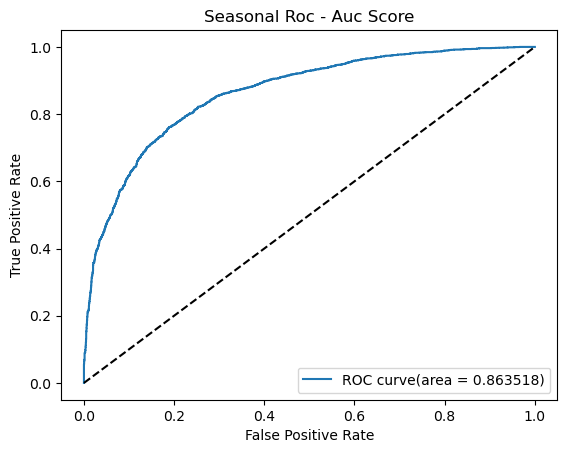

In [268]:
fpr, tpr, thresholds = roc_curve(y_test_seas, cat_model_roc_seas)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, label='ROC curve(area = %0.6f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Seasonal Roc - Cat Boost')
plt.legend(loc="lower right")
plt.show()

<font size="5"> Analysing Determinants of vaccination uptake </font> 

0 - Not taken the Vaccination 
<br>
1 - Taken the Vaccination

In [214]:
df = pd.read_csv('training_set_features.csv')

In [215]:
combined = pd.merge(df, label, on='respondent_id')

In [216]:
combined.head()

,respondent_id,h1n1_concern,h1n1_knowledge,behavioral_antiviral_meds,behavioral_avoidance,behavioral_face_mask,behavioral_wash_hands,behavioral_large_gatherings,behavioral_outside_home,behavioral_touch_face,...,rent_or_own,employment_status,hhs_geo_region,census_msa,household_adults,household_children,employment_industry,employment_occupation,h1n1_vaccine,seasonal_vaccine
0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,...,Own,Not in Labor Force,oxchjgsf,Non-MSA,0.0,0.0,NaN,NaN,0,0
1,1,3.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,...,Rent,Employed,bhuqouqj,"MSA, Not Principle City",0.0,0.0,pxcmvdjn,xgwztkwe,0,1
2,2,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,Own,Employed,qufhixun,"MSA, Not Principle City",2.0,0.0,rucpziij,xtkaffoo,0,0
3,3,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,...,Rent,Not in Labor Force,lrircsnp,"MSA, Principle City",0.0,0.0,NaN,NaN,0,1
4,4,2.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,...,Own,Employed,qufhixun,"MSA, Not Principle City",1.0,0.0,wxleyezf,emcorrxb,0,0


**- Comparing respondents got Vaccination by SEX**

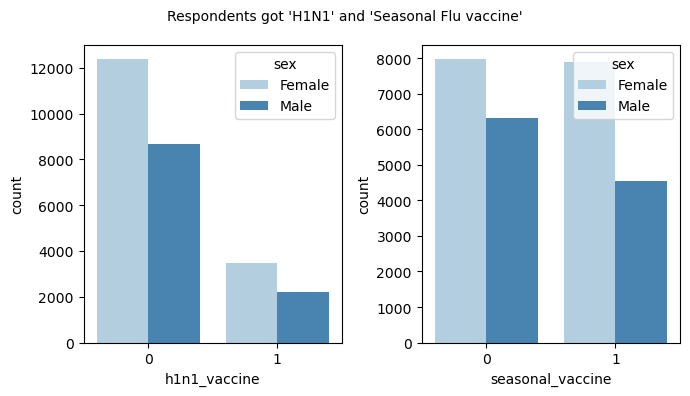

In [217]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(x='h1n1_vaccine', data=combined, ax=axes[0], hue='sex', palette='Blues')
sns.countplot(x='seasonal_vaccine', data=combined, ax=axes[1], hue='sex',palette='Blues')

fig.subplots_adjust(wspace=0.6)

plt.suptitle("Respondents got 'H1N1' and 'Seasonal Flu vaccine'", ha='center', fontsize=10)
plt.tight_layout()
plt.show()

**- Analysing whether chronic medical condition people took vaccination**

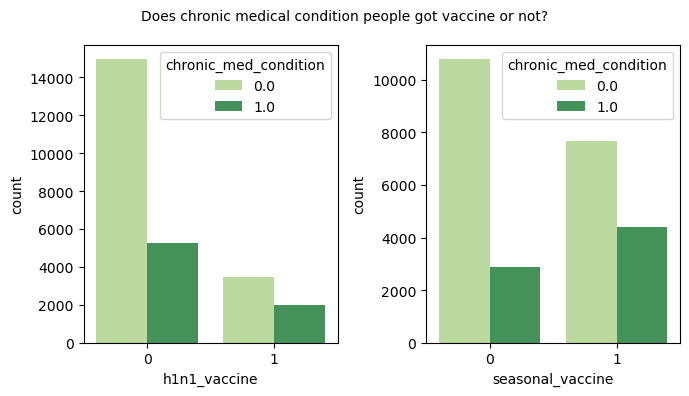

In [218]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(x='h1n1_vaccine', data=combined, ax=axes[0], hue='chronic_med_condition', palette='YlGn')
sns.countplot(x='seasonal_vaccine', data=combined, ax=axes[1], hue='chronic_med_condition',palette='YlGn')

fig.subplots_adjust(wspace=0.6)

plt.suptitle("Does chronic medical condition people got vaccine or not?", ha='center', fontsize=10)
plt.tight_layout()
plt.show()

**- Comparing Age Group and people took Vaccination**

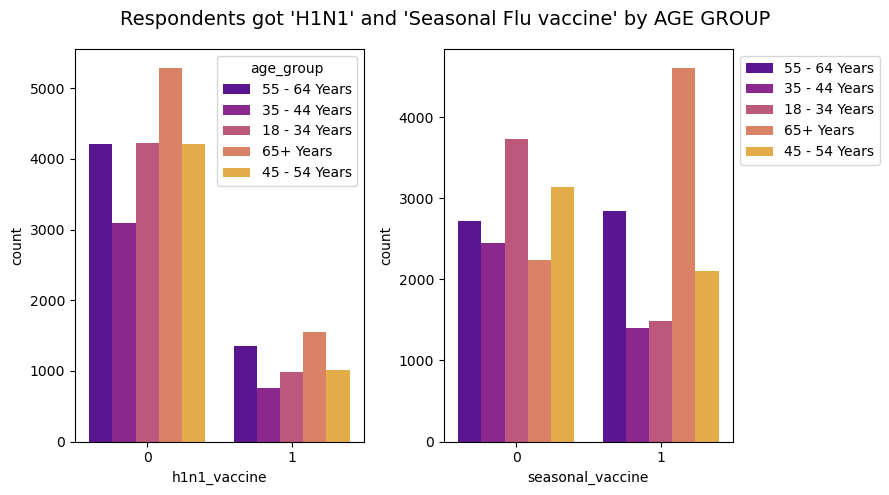

In [219]:
fig, axes = plt.subplots(ncols=2, figsize=(9, 5))

sns.countplot(x='h1n1_vaccine', data=combined, ax=axes[0], hue='age_group', palette='plasma')
sns.countplot(x='seasonal_vaccine', data=combined, ax=axes[1], hue='age_group', palette='plasma')

fig.subplots_adjust(wspace=0.6)

plt.suptitle("Respondents got 'H1N1' and 'Seasonal Flu vaccine' by AGE GROUP", ha='center', fontsize=14)

handles, labels = axes[1].get_legend_handles_labels()

plt.legend(handles, labels, bbox_to_anchor=(1, 1), loc='upper left')
plt.tight_layout()
plt.show()

**- Comparing Health Worker's vaccination status**

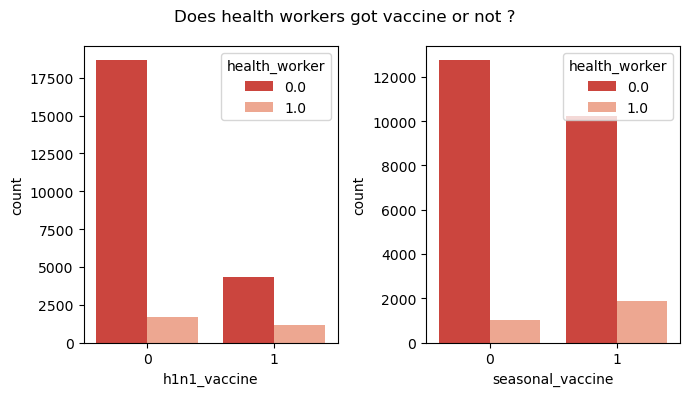

In [220]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(x='h1n1_vaccine', data=combined, ax=axes[0], hue='health_worker', palette='Reds_r')
sns.countplot(x='seasonal_vaccine', data=combined, ax=axes[1], hue='health_worker',palette='Reds_r')

fig.subplots_adjust(wspace=0.6)

plt.suptitle("Does health workers got vaccine or not ?", ha='center')
plt.tight_layout()
plt.show()

**- Vaccination status based on people's concern and knowledge.**

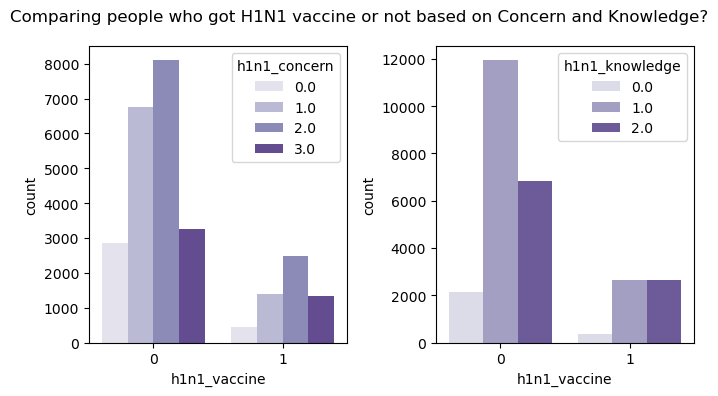

In [221]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(x='h1n1_vaccine', data=combined, ax=axes[0], hue='h1n1_concern', palette='Purples')
sns.countplot(x='h1n1_vaccine', data=combined, ax=axes[1], hue='h1n1_knowledge',palette='Purples')

fig.subplots_adjust(wspace=0.6)

plt.suptitle("Comparing people who got H1N1 vaccine or not based on Concern and Knowledge?", ha='center')
plt.tight_layout()
plt.show()

**-Comparing people's opinion towards vaccine effectiveness and their vaccination status**

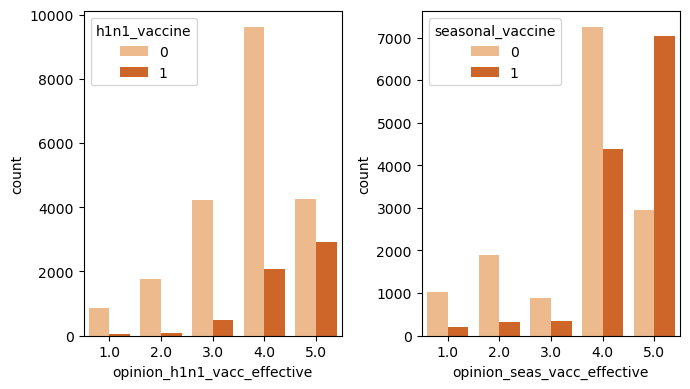

In [222]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(x='opinion_h1n1_vacc_effective', data=combined, ax=axes[0], hue='h1n1_vaccine', palette='Oranges')
sns.countplot(x='opinion_seas_vacc_effective', data=combined, ax=axes[1], hue='seasonal_vaccine',palette='Oranges')

fig.subplots_adjust(wspace=0.6)

plt.tight_layout()
plt.show()

**- Checking whether Doctor's Recommendedation is Influencing respondents Vaccination status.**

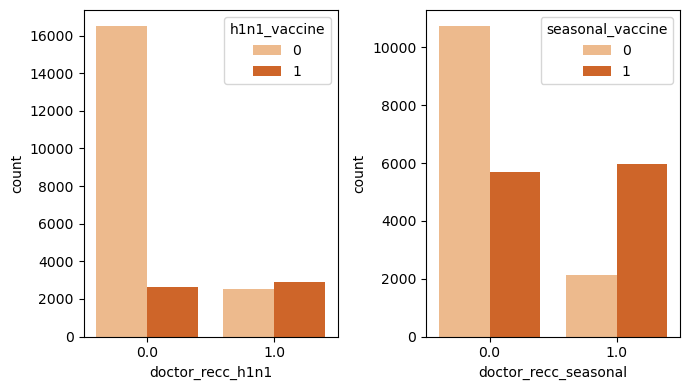

In [223]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(x='doctor_recc_h1n1', data=combined, ax=axes[0], hue='h1n1_vaccine', palette='Oranges')
sns.countplot(x='doctor_recc_seasonal', data=combined, ax=axes[1], hue='seasonal_vaccine',palette='Oranges')

fig.subplots_adjust(wspace=0.6)

plt.tight_layout()
plt.show()

**- Comparing education level to the vaccination status**

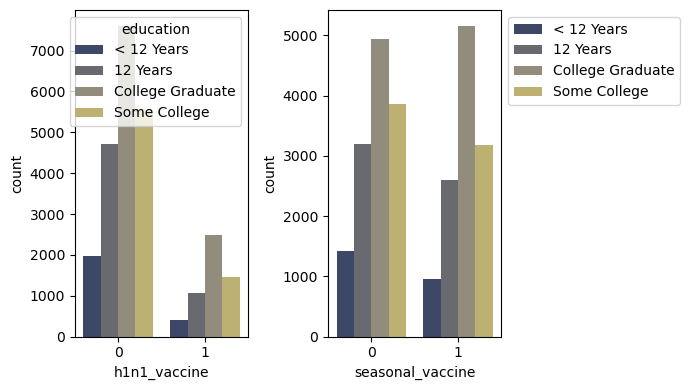

In [224]:
fig, axes = plt.subplots(ncols=2, figsize=(7, 4))

sns.countplot(hue='education', data=combined, ax=axes[0], x='h1n1_vaccine', palette='cividis')
sns.countplot(hue='education', data=combined, ax=axes[1], x='seasonal_vaccine',palette='cividis')

handles, labels = axes[1].get_legend_handles_labels()
plt.legend(handles, labels, bbox_to_anchor=(1, 1), loc='upper left')

fig.subplots_adjust(wspace=0.6)

plt.tight_layout()
plt.show()

In [225]:
h1_industry = px.histogram(combined, x='h1n1_vaccine', color='employment_industry',
                   barmode='group', histfunc='count', template='plotly_white',
                           
                  title="Total 'H1N1' Vaccination status Industry-wise")

h1_industry.show()

In [226]:
seas_industry = px.histogram(combined, x='seasonal_vaccine', color='employment_industry',
                   barmode='group', histfunc='count', template='plotly_white',
                             
                  title="Total 'Seasonal Flu' Vaccination status Industry-wise")

seas_industry.show()

In [227]:
h1_emp = px.histogram(combined, x='h1n1_vaccine', color='employment_occupation',
                   barmode='group', histfunc='count', template='plotly_white',
                      
                  title=" Total 'H1N1' Vaccination status Occupation-wise")

h1_emp.show()

In [228]:
seas_emp = px.histogram(combined, x='seasonal_vaccine', color='employment_occupation',
                   barmode='group', histfunc='count', template='plotly_white',
                  title=" Total 'Seasonal Flu' Vaccination status Occupation-wise")

seas_emp.show()

**- Comparing vaccination uptake over hhs_geo_region**

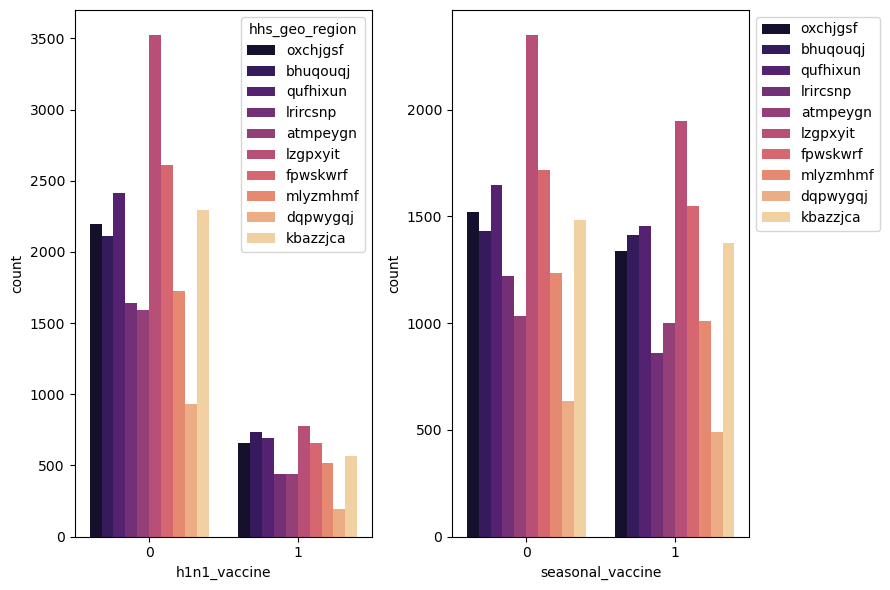

In [229]:
fig, axes = plt.subplots(ncols=2, figsize=(9, 6))

sns.countplot(hue='hhs_geo_region', data=combined, ax=axes[0], x='h1n1_vaccine', palette='magma')
sns.countplot(hue='hhs_geo_region', data=combined, ax=axes[1], x='seasonal_vaccine',palette='magma',)

fig.subplots_adjust(wspace=0.6)

handles, labels = axes[1].get_legend_handles_labels()
plt.legend(handles, labels, bbox_to_anchor=(1, 1), loc='upper left')

plt.tight_layout()
plt.show()

**- Comparing Census MSA over vaccination**

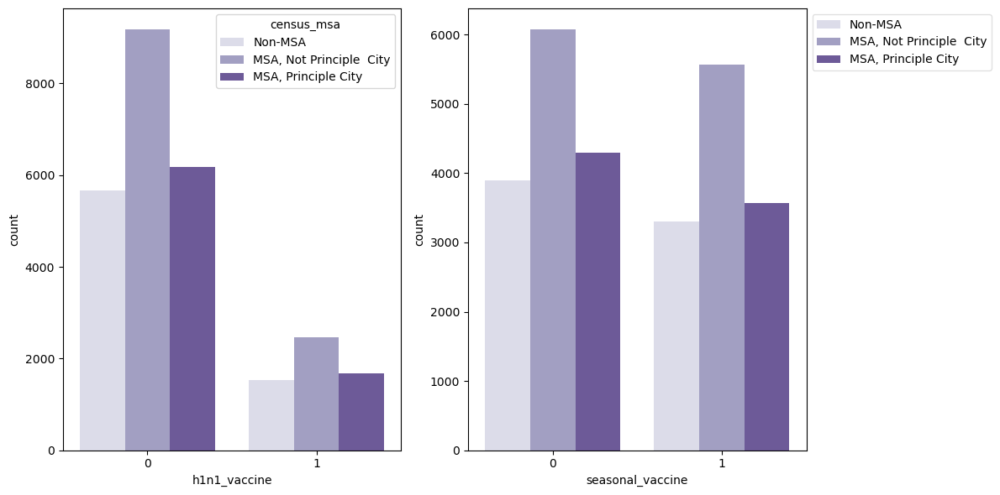

In [281]:
fig, axes = plt.subplots(ncols=2, figsize=(12, 6))

sns.countplot(hue='census_msa', data=combined, ax=axes[0], x='h1n1_vaccine', palette='Purples')
sns.countplot(hue='census_msa', data=combined, ax=axes[1], x='seasonal_vaccine',palette='Purples')

# handles, labels = axes[1].get_legend_handles_labels()
# plt.legend(handles, labels, bbox_to_anchor=(1, 1), loc='upper left')


fig.subplots_adjust(wspace=0.6)

plt.tight_layout()
 plt.show()

**- Comparing Income Poverty people over vaccination uptake**

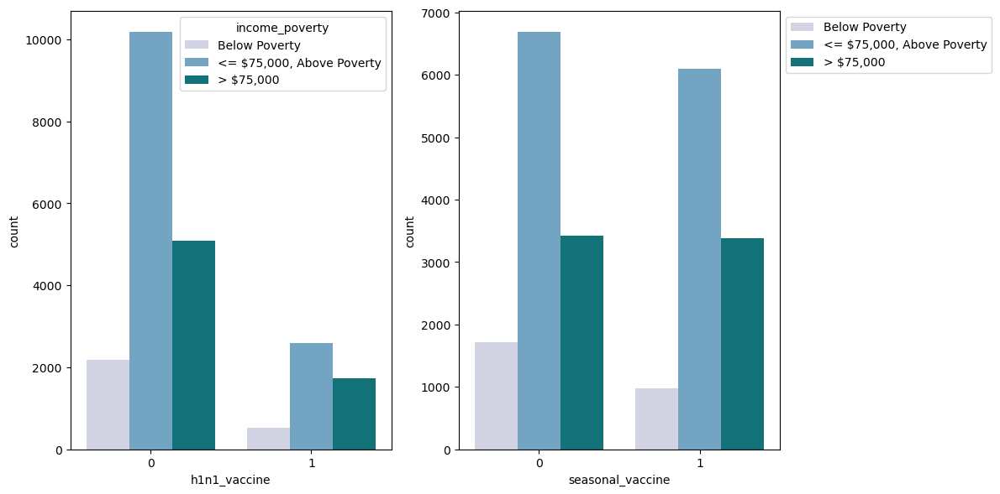

In [279]:
fig, axes = plt.subplots(ncols=2, figsize=(12, 6))

sns.countplot(hue='income_poverty', data=combined, ax=axes[0], x='h1n1_vaccine', palette='PuBuGn')
sns.countplot(hue='income_poverty', data=combined, ax=axes[1], x='seasonal_vaccine',palette='PuBuGn')

handles, labels = axes[1].get_legend_handles_labels()
plt.legend(handles, labels, bbox_to_anchor=(1, 1), loc='upper left')

fig.subplots_adjust(wspace=0.6)

plt.tight_layout()
plt.show()

**- Comparing the Employment Status over** 

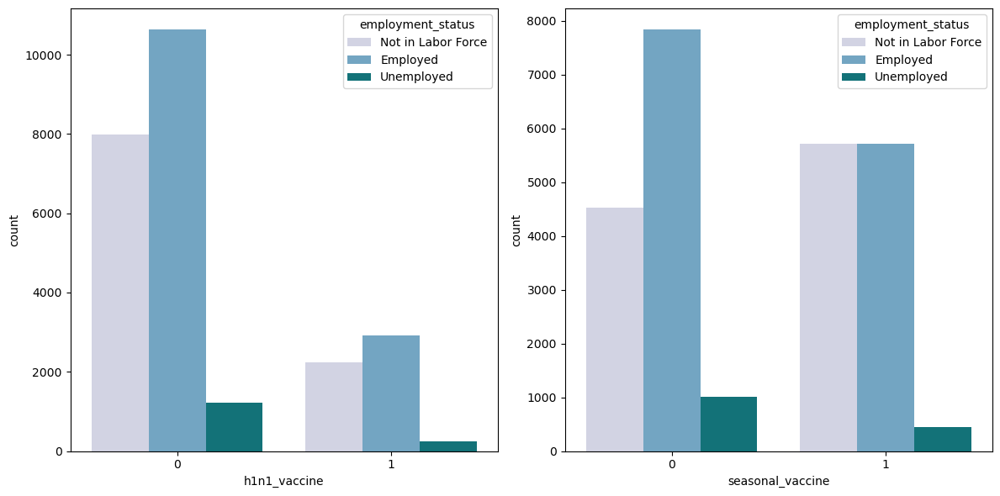

In [232]:
fig, axes = plt.subplots(ncols=2, figsize=(12, 6))

sns.countplot(hue='employment_status', data=combined, ax=axes[0], x='h1n1_vaccine', palette='PuBuGn')
sns.countplot(hue='employment_status', data=combined, ax=axes[1], x='seasonal_vaccine',palette='PuBuGn')

fig.subplots_adjust(wspace=0.6)

plt.tight_layout()
plt.show()

<font size="5"> Predicting the model for Driven Data Submission </font> 

In [233]:
test = pd.read_csv('test_set_features.csv')

In [234]:
test.shape

(26708, 36)

In [235]:
for i, row in test[test['employment_occupation'].isna()].iterrows():
    conditions = (test["employment_status"]=="Unemployed")
    if conditions.any():
        test.loc[i, 'employment_occupation'] = 'unemployed_occupation'
        
for i, row in test[test['employment_occupation'].isna()].iterrows():
    conditions = (test["employment_status"]=="Not in Labor Force")
    if conditions.any():
        test.loc[i, 'employment_occupation'] = 'Not_in_laborforce'
        
for i, row in test[test['employment_occupation'].isna()].iterrows():
    conditions = (test["employment_status"]=="Employed")
    if conditions.any():
        test.loc[i, 'employment_occupation'] = 'other_occupation'
        
for i, row in test[test['employment_industry'].isna()].iterrows():
    conditions = (test["employment_status"]=="Unemployed")
    if conditions.any():
        test.loc[i, 'employment_industry'] = 'unemployed_in_industry'
        
for i, row in test[test['employment_industry'].isna()].iterrows():
    conditions = (test["employment_status"]=="Not in Labor Force")
    if conditions.any():
        test.loc[i, 'employment_industry'] = 'Not_in_laborforce'
        
for i, row in test[test['employment_industry'].isna()].iterrows():
    conditions = (test["employment_status"]=="Employed")
    if conditions.any():
        test.loc[i, 'employment_industry'] = 'other_industry'
        
income_poverty_nan = 'refused_or_unknown'
marital_status_nan = 'refused_or_other_category'
employment_status_nan = 'refused_or_other_category'
rent_or_own_nan = 'other_or_refused'
education_nan = 'refused_or_unknown'


test['income_poverty'].fillna(income_poverty_nan, inplace=True)
test['marital_status'].fillna(marital_status_nan, inplace=True)
test['employment_status'].fillna(employment_status_nan, inplace=True)
test['rent_or_own'].fillna(rent_or_own_nan, inplace=True)
test['education'].fillna(education_nan, inplace=True)

In [236]:
for features in ordinal_columns:
    test[features] = le.fit_transform(test[features])

In [237]:
test = pd.get_dummies(test, columns=category_columns, drop_first=True)

In [238]:
test.drop('respondent_id', axis=1, inplace=True)

In [239]:
h1n1_test_proba = h1n1_model_tuned.predict_proba(test)

In [240]:
seas_test_proba = seasonal_model_tuned.predict_proba(test)

In [241]:
h1n1_probability = h1n1_test_proba[:,1].reshape(-1,1)

In [242]:
seasonal_probability = seas_test_proba[:,1].reshape(-1,1)

In [243]:
h1n1_probability

array([[0.11101206],
       [0.03347328],
       [0.20636103],
       ...,
       [0.17713897],
       [0.03206827],
       [0.6214547 ]], dtype=float32)

In [244]:
seasonal_probability

array([[0.1995434 ],
       [0.03351166],
       [0.6610072 ],
       ...,
       [0.18738483],
       [0.29263285],
       [0.6720225 ]], dtype=float32)

In [271]:
submission = pd.read_csv('submission_format.csv')

In [272]:
submission.drop(['h1n1_vaccine','seasonal_vaccine'], axis=1, inplace=True)

In [273]:
submission['h1n1_vaccine'] = h1n1_probability

In [274]:
submission['seasonal_vaccine'] = seasonal_probability

In [275]:
submission.set_index("respondent_id",inplace=True)

In [276]:
submission.head()

,h1n1_vaccine,seasonal_vaccine
respondent_id,,
26707,0.111012,0.199543
26708,0.033473,0.033512
26709,0.206361,0.661007
26710,0.715332,0.882149
26711,0.308536,0.537591


In [ ]:
# Good To Go.

<font size="5">Instruction for Other Implementation</font>

**- Sequential Feature Selection using MLXtend and XGboost (Forward Method)** 
<br>
**- Feature Engineering using XGboost (without dropping redundant columns)** 
<br>
**- Feature Engineering using XGboost (dropping redundant columns)** 
<br>
**- Logistic Regression with mode**
<br>
**- SVM with -1 imputation (Hyperparameter Tuning)**


<font size="5">**LINK FOR GITHUB :** https://github.com/AdarshGK99/Coursework-for-COMP4030</font>

**- The file was uploaded on <u>18th May 2023</u> and it can we verified in the repository.**

Other implementation are posted in github and codes are avaibalble in the repository.

<br>For further detailed information, check the read me file in the shared repository and codes are ready to run. 